# Set up

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import random
import xrft
from torch.utils.data import DataLoader, TensorDataset
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
import matplotlib.ticker as ticker

from utils import *
from train_v1 import *
from loss import *
from UNET import *

from scipy.optimize import curve_fit
import warnings
from matplotlib.colors import BoundaryNorm
from matplotlib.colors import LinearSegmentedColormap

In [2]:
base_path = "gs://leap-persistent/YueWang/SSH/data"

def open_zarr(path):
    return xr.open_zarr(path, consolidated=True)

train = open_zarr(f"{base_path}/train_eps3.zarr").compute()
val = open_zarr(f"{base_path}/val_eps3.zarr").compute()
test = open_zarr(f"{base_path}/test_eps3.zarr").compute()
zca = open_zarr(f"{base_path}/zca_eps3.zarr").compute()

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

if torch.cuda.is_available():
    torch.cuda.manual_seed(42)
    torch.cuda.manual_seed_all(42)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

zca_Vt_ubm = torch.from_numpy(zca.zca_Vt_ubm.values).float().to(device)
zca_mean_ubm = torch.from_numpy(zca.zca_mean_ubm.values).float().to(device)
zca_scale_ubm = torch.from_numpy(zca.zca_scale_ubm.values).float().to(device)

batch_size = 64

x_test = torch.from_numpy(test.ssh.values).float().unsqueeze(1).to(device)
y_test = torch.from_numpy(test.ubm.values).float().unsqueeze(1).to(device)

test_dataset = TensorDataset(x_test, y_test)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


def inverse_zca_transform_torch(data_zca, Vt, scale, data_mean):
    """
    Inverse ZCA transformation in PyTorch (GPU-compatible).
    """
    num_images, img_rows, img_cols = data_zca.shape
    D = img_rows * img_cols
    data_zca_flat = data_zca.view(num_images, D)
    
    # Handle NaNs by imputing with 0 (mean in original space)
    mask = ~torch.isnan(data_zca_flat)
    data_zca_flat_clean = torch.where(mask, data_zca_flat, torch.zeros_like(data_zca_flat))
    
    # Step 1: Project to PCA space
    transformed = torch.matmul(data_zca_flat_clean, Vt.T)
    # Step 2: Undo scaling
    rescaled = transformed / scale
    # Step 3: Project back to original space
    original_centered = torch.matmul(rescaled, Vt)
    data_reconstructed_flat = original_centered + data_mean
    
    # Restore NaNs and reshape
    data_reconstructed_flat[~mask] = torch.nan
    return data_reconstructed_flat.view(num_images, img_rows, img_cols)

def inverse_zca_variance_torch(var_zca, Vt, scale):
    """
    Propagate variance through inverse ZCA in PyTorch.
    """
    num_images, img_rows, img_cols = var_zca.shape
    D = img_rows * img_cols
    var_zca_flat = var_zca.view(num_images, D)
    
    # Step 1: Project variance through Vt.T
    var_step1 = torch.matmul(var_zca_flat, (Vt.T ** 2))
    # Step 2: Scale variance
    var_step2 = var_step1 / (scale ** 2)
    # Step 3: Project variance through Vt
    var_data_flat = torch.matmul(var_step2, (Vt ** 2))
    
    return var_data_flat.view(num_images, img_rows, img_cols)

def inverse_zca_transform_sigma_torch(sigma_zca, Vt, scale):
    """
    Propagate standard deviation through inverse ZCA in PyTorch.
    """
    var_zca = sigma_zca ** 2
    var_data = inverse_zca_variance_torch(var_zca, Vt, scale)
    return torch.sqrt(var_data)
    
def evaluate_model_zca(model, device, test_loader, Vt, scale, data_mean, ssh_test, checkpoint_path, probabilistic=False):
    model = model.to(device)
    model.eval()
    eps = 1e-6

    # Load checkpoint
    if os.path.isfile(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        print(f"Loaded model from {checkpoint_path}")
    else:
        raise FileNotFoundError(f"No checkpoint at {checkpoint_path}")

    # Convert ZCA params to PyTorch tensors on the same device
    Vt_tensor = torch.from_numpy(Vt).float().to(device)
    scale_tensor = torch.from_numpy(scale).float().to(device)
    data_mean_tensor = torch.from_numpy(data_mean).float().to(device)

    # Collect predictions
    mu_zca_list, sigma_zca_list = [], []
    
    with torch.no_grad():
        for batch_x, _ in test_loader:
            batch_x = batch_x.to(device)
            outputs = model(batch_x)
            
            if probabilistic:
                mu = outputs[:, 0, ...]
                log_sigma = outputs[:, 1, ...]
                sigma = torch.exp(log_sigma).clamp(min=eps)
                mu_zca_list.append(mu)
                sigma_zca_list.append(sigma)
            else:
                mu_zca_list.append(outputs)

    # Process outputs
    mu_zca = torch.cat(mu_zca_list, dim=0)
    if probabilistic:
        sigma_zca = torch.cat(sigma_zca_list, dim=0)
        # Propagate uncertainty on GPU
        sigma_ubm = inverse_zca_transform_sigma_torch(sigma_zca, Vt_tensor, scale_tensor)
        sigma_ubm_np = sigma_ubm.cpu().numpy()
        sigma_zca_np = sigma_zca.cpu().numpy()
    else:
        sigma_zca = None
        sigma_ubm_np = None

    # Invert ZCA for mean prediction
    ubm_prediction = inverse_zca_transform_torch(mu_zca, Vt_tensor, scale_tensor, data_mean_tensor)
    ubm_prediction_np = ubm_prediction.cpu().numpy()
    
    # Convert to xarray DataArrays (assuming `xr_da` handles numpy inputs)
    mu_zca_da = xr_da(mu_zca.cpu().numpy(), ssh_test)
    sigma_zca_da = xr_da(sigma_zca_np, ssh_test) if probabilistic else None
    sigma_ubm_da = xr_da(sigma_ubm_np, ssh_test) if probabilistic else None
    ubm_da = xr_da(ubm_prediction_np, ssh_test)
    bm_da = ssh_test - ubm_da

    return mu_zca_da, sigma_zca_da, sigma_ubm_da, ubm_da, bm_da

mu_zca, sigma_zca, ubm_sigma_zca, ubm_mu_zca, bm_mu_zca = evaluate_model_zca(
    UNet(in_channels=1, out_channels=2, initial_features=32, depth=4), device, test_loader,
    zca.zca_Vt_ubm.values, zca.zca_scale_ubm.values, zca.zca_mean_ubm.values,
    test.ssh,
    '/home/jovyan/GRL/checkpoint/eps9.pth',
    probabilistic=True
)



def evaluate_model(model, device, test_loader, ssh_test, checkpoint_path):
    model = model.to(device)
    model.eval()

    # Load checkpoint
    if os.path.isfile(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        print(f"Loaded model from {checkpoint_path}")
    else:
        raise FileNotFoundError(f"No checkpoint at {checkpoint_path}")

    # Collect predictions
    predictions_list = []
    
    with torch.no_grad():
        for batch_x, _ in test_loader:
            batch_x = batch_x.to(device)
            outputs = model(batch_x)
            predictions_list.append(outputs)

    # Process outputs
    predictions = torch.cat(predictions_list, dim=0)
    predictions_np = predictions.squeeze(1).cpu().numpy()
    
    # Convert to xarray DataArrays (assuming `xr_da` handles numpy inputs)
    ubm_da = xr_da(predictions_np, ssh_test)
    bm_da = ssh_test - ubm_da

    return ubm_da, bm_da

ubm_pred_unet, bm_pred_unet = evaluate_model(
    UNet(in_channels=1, out_channels=1, initial_features=32, depth=4), 
    device, 
    test_loader,
    test.ssh,
    '/home/jovyan/GRL/checkpoint/unet.pth'
)


/tmp/ipykernel_391/2657395842.py:82: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Loaded model from /home/jovyan/GRL/checkpoint/eps9.pth


/tmp/ipykernel_391/2657395842.py:151: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Loaded model from /home/jovyan/GRL/checkpoint/unet.pth


# ZCA

/srv/conda/envs/notebook/lib/python3.12/site-packages/xrft/xrft.py:47: FutureWarning: Please provide the name of window adhering to scipy.signal.windows. The boolean option will be deprecated in future releases.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.12/site-packages/xrft/xrft.py:1054: FutureWarning: Isotropic wavenumber larger than the Nyquist wavenumber may result.
  warnings.warn(msg, FutureWarning)
/srv/conda/envs/notebook/lib/python3.12/site-packages/xrft/xrft.py:47: FutureWarning: Please provide the name of window adhering to scipy.signal.windows. The boolean option will be deprecated in future releases.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.12/site-packages/xrft/xrft.py:1054: FutureWarning: Isotropic wavenumber larger than the Nyquist wavenumber may result.
  warnings.warn(msg, FutureWarning)


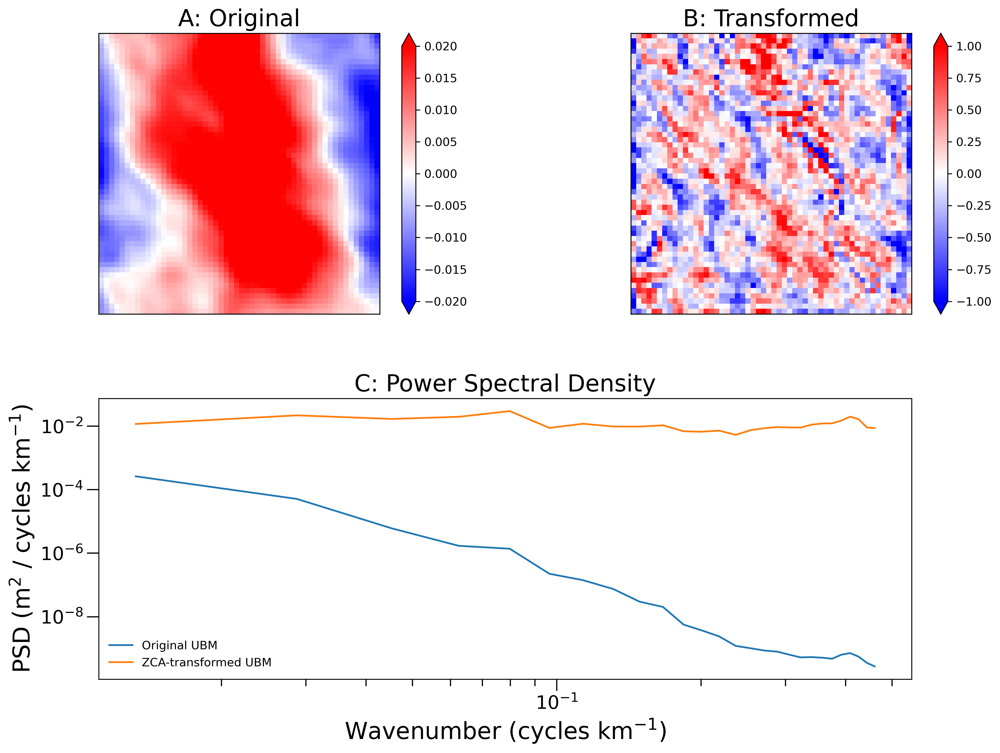

In [4]:
dx_km = 1.5          # grid spacing in kilometres

def calculate_psd_km(field, dx=dx_km):
    """
    field : 2-D numpy array [i, j]   (e.g., ubm sample)
    dx    : km per grid cell
    returns: PSD with coords in cycles km⁻¹ and values in m²/(cycles km⁻¹)
    """
    i_km = np.arange(field.shape[0]) * dx
    j_km = np.arange(field.shape[1]) * dx
    da = xr.DataArray(
        field,
        dims=['i', 'j'],
        coords={'i': i_km, 'j': j_km},
        name='field'
    )
    return isotropic_spectra(da)   

ubm = train.ubm.isel(sample=155).values
zca = train.zca_ubm.isel(sample=155).values
psd_ubm = calculate_psd_km(ubm)
psd_zca = calculate_psd_km(zca)

def plot_comparison_km(ubm, zca, psd_ubm, psd_zca):

    fig = plt.figure(figsize=(15, 10), dpi=300)
    
    # Use GridSpec for precise control of subplot placement
    gs = fig.add_gridspec(2, 2, height_ratios=[1, 1], width_ratios=[1, 1],
                         hspace=0.3, wspace=0.2)
    
    # Top row: Original and Transformed (A and B)
    ax1 = fig.add_subplot(gs[0, 0])
    ax3 = fig.add_subplot(gs[0, 1])
    
    # Bottom row: PSD plot spanning both columns (C)
    ax2 = fig.add_subplot(gs[1, :])
    
    # (A) Original field
    im1 = ax1.imshow(ubm, cmap='bwr', vmin=-0.02, vmax=0.02)
    ax1.set_title('A: Original', fontsize=20)
    ax1.set_xticks([]); ax1.set_yticks([])
    cbar1 = plt.colorbar(im1, ax=ax1, shrink=1, extend='both')
    
    # (B) ZCA field
    im2 = ax3.imshow(zca, cmap='bwr', vmin=-1, vmax=1)
    ax3.set_title('B: Transformed', fontsize=20)
    ax3.set_xticks([]); ax3.set_yticks([])
    cbar2 = plt.colorbar(im2, ax=ax3, shrink=1, extend='both')
    
    # Ensure the two top plots have the same aspect ratio and size
    ax1.set_aspect('equal')
    ax3.set_aspect('equal')
    
    # (C) isotropic PSD (log–log) - full width in second row
    ax2.loglog(psd_ubm.freq_r, psd_ubm, label='Original UBM')
    ax2.loglog(psd_zca.freq_r, psd_zca, label='ZCA-transformed UBM')
    ax2.set_xlabel(r'Wavenumber (cycles km$^{-1}$)', fontsize=20)
    ax2.set_ylabel(r'PSD (m$^{2}$ / cycles km$^{-1}$)', fontsize=20)
    ax2.legend(frameon=False)
    ax2.grid(False)
    ax2.set_title('C: Power Spectral Density', fontsize=20)

    # Increase tick sizes and font size for the PSD plot (ax2)
    ax2.tick_params(axis='both', which='major', length=10, width=1, labelsize=16)
    ax2.tick_params(axis='both', which='minor', length=6, width=1, labelsize=16)
    
    # Adjust PSD plot position to align with the panels above
    pos1 = ax1.get_position()
    pos3 = ax3.get_position()
    pos2 = ax2.get_position()
    
    # Set PSD plot position to match the width of the two panels above combined
    new_pos2 = [pos1.x0, pos2.y0, pos3.x0 + pos3.width - pos1.x0, pos2.height]
    ax2.set_position(new_pos2)
    
    return fig

fig = plot_comparison_km(ubm, zca, psd_ubm, psd_zca)
plt.savefig('/home/jovyan/GRL/figures/zca_comparison.pdf', dpi=300, bbox_inches='tight')
plt.show()

# Choose Samples

In [5]:
mask = test.ubm.isnull().any(dim=['i', 'j'])

def remove_nan_samples(da, mask):
    return da.isel(sample=~mask)

ubm_true_clean = remove_nan_samples(test.ubm, mask)
ubm_pre_zca_clean = remove_nan_samples(ubm_mu_zca, mask)
ubm_uncertainty_clean = remove_nan_samples(ubm_sigma_zca, mask)
ubm_pre_unet_clean = remove_nan_samples(ubm_pred_unet, mask)

bm_true_clean = remove_nan_samples(test.bm, mask)
bm_pre_zca_clean = remove_nan_samples(bm_mu_zca, mask)
bm_pre_unet_clean = remove_nan_samples(bm_pred_unet, mask)

ssh_clean = remove_nan_samples(test.ssh, mask)

mu_zca_clean = remove_nan_samples(mu_zca, mask)
sigma_zca_clean = remove_nan_samples(sigma_zca, mask)

In [6]:
import numpy as np
from scipy.stats import pearsonr
import xarray as xr

def find_best_worst_correlation_indices(true_array, pred_array):
    """
    Find indices of samples with highest and lowest correlation between true and predicted values.
    Works with xarray DataArrays.
    
    Parameters:
    true_array: xarray DataArray of true values 
    pred_array: xarray DataArray of predicted values
    
    Returns:
    best_indices: Indices of 30 samples with highest correlation
    worst_indices: Indices of 30 samples with lowest correlation
    correlations: Array of correlation values for all samples
    """
    n_samples = len(true_array.sample)
    correlations = np.zeros(n_samples)
    
    # Calculate correlation for each sample
    for i in range(n_samples):
        # Get numpy arrays from the DataArrays for this sample
        true_values = true_array.isel(sample=i).values
        pred_values = pred_array.isel(sample=i).values
        
        # Flatten the 2D numpy arrays to 1D for correlation calculation
        true_flat = true_values.flatten()
        pred_flat = pred_values.flatten()
        
        # Calculate Pearson correlation coefficient
        # Handle potential warnings or errors with try-except
        try:
            corr, _ = pearsonr(true_flat, pred_flat)
            # Handle NaN values that might occur
            if np.isnan(corr):
                correlations[i] = -1  # Assign a low value to NaN correlations
            else:
                correlations[i] = corr
        except Exception as e:
            print(f"Error calculating correlation for sample {i}: {e}")
            correlations[i] = -1  # Assign a low value if correlation calculation fails
    
    # Find indices of highest correlations (best samples)
    best_indices = np.argsort(correlations)[-30:][::-1]  # Sort in descending order
    
    # Find indices of lowest correlations (worst samples)
    worst_indices = np.argsort(correlations)[:30]
    
    return best_indices, worst_indices, correlations

# Usage:
best_indices, worst_indices, correlations = find_best_worst_correlation_indices(ubm_true_clean, ubm_pre_zca_clean)

# Print some statistics
print(f"Best sample index: {best_indices[0]} with correlation: {correlations[best_indices[0]]:.4f}")
print(f"Worst sample index: {worst_indices[0]} with correlation: {correlations[worst_indices[0]]:.4f}")
print(f"Average correlation across all samples: {np.mean(correlations):.4f}")

# For debugging: Print a few sample correlations
print("\nSample correlations (index: correlation):")
for i in range(min(5, len(best_indices))):
    print(f"Best #{i+1}: {best_indices[i]}: {correlations[best_indices[i]]:.4f}")
for i in range(min(5, len(worst_indices))):
    print(f"Worst #{i+1}: {worst_indices[i]}: {correlations[worst_indices[i]]:.4f}")

Best sample index: 3127 with correlation: 0.9728
Worst sample index: 4766 with correlation: -0.7454
Average correlation across all samples: 0.4009

Sample correlations (index: correlation):
Best #1: 3127: 0.9728
Best #2: 67: 0.9678
Best #3: 2313: 0.9648
Best #4: 5925: 0.9646
Best #5: 4543: 0.9643
Worst #1: 4766: -0.7454
Worst #2: 959: -0.6453
Worst #3: 5360: -0.6325
Worst #4: 3499: -0.6195
Worst #5: 6647: -0.6189


# Figures

## Selection

In [7]:
def calculate_gradient_magnitude(field):
    dy, dx = np.gradient(field)
    magnitude = np.sqrt(dx**2 + dy**2)
    return magnitude

# Best Sample
best_ssh_sample = ssh_clean.isel(sample=67).values

best_mu_zca_sample = mu_zca_clean.isel(sample=67).values
best_sigma_zca_sample = sigma_zca_clean.isel(sample=67).values

best_ubm_pre_zca_sample = ubm_pre_zca_clean.isel(sample=67).values
best_ubm_pre_unet_sample = ubm_pre_unet_clean.isel(sample=67).values
best_ubm_true_sample = ubm_true_clean.isel(sample=67).values
best_ubm_uncertainty_sample = ubm_uncertainty_clean.isel(sample=67).values

best_bm_pre_zca_sample = bm_pre_zca_clean.isel(sample=67).values
best_bm_pre_unet_sample = bm_pre_unet_clean.isel(sample=67).values
best_bm_true_sample = bm_true_clean.isel(sample=67).values


best_ssh_grad_sample = calculate_gradient_magnitude(best_ssh_sample)

best_ubm_pre_zca_grad_sample = calculate_gradient_magnitude(best_ubm_pre_zca_sample)
best_ubm_pre_unet_grad_sample = calculate_gradient_magnitude(best_ubm_pre_unet_sample)
best_ubm_true_grad_sample = calculate_gradient_magnitude(best_ubm_true_sample)


best_bm_pre_zca_grad_sample = calculate_gradient_magnitude(best_bm_pre_zca_sample)
best_bm_pre_unet_grad_sample = calculate_gradient_magnitude(best_bm_pre_unet_sample)
best_bm_true_grad_sample = calculate_gradient_magnitude(best_bm_true_sample)


# Worst Sample
worst_ssh_sample = ssh_clean.isel(sample=959).values

worst_mu_zca_sample = mu_zca_clean.isel(sample=959).values
worst_sigma_zca_sample = sigma_zca_clean.isel(sample=959).values

worst_ubm_pre_zca_sample = ubm_pre_zca_clean.isel(sample=959).values
worst_ubm_pre_unet_sample = ubm_pre_unet_clean.isel(sample=959).values
worst_ubm_true_sample = ubm_true_clean.isel(sample=959).values
worst_ubm_uncertainty_sample = ubm_uncertainty_clean.isel(sample=959).values

worst_bm_pre_zca_sample = bm_pre_zca_clean.isel(sample=959).values
worst_bm_pre_unet_sample = bm_pre_unet_clean.isel(sample=959).values
worst_bm_true_sample = bm_true_clean.isel(sample=959).values


worst_ssh_grad_sample = calculate_gradient_magnitude(worst_ssh_sample)

worst_ubm_pre_zca_grad_sample = calculate_gradient_magnitude(worst_ubm_pre_zca_sample)
worst_ubm_pre_unet_grad_sample = calculate_gradient_magnitude(worst_ubm_pre_unet_sample)
worst_ubm_true_grad_sample = calculate_gradient_magnitude(worst_ubm_true_sample)


worst_bm_pre_zca_grad_sample = calculate_gradient_magnitude(worst_bm_pre_zca_sample)
worst_bm_pre_unet_grad_sample = calculate_gradient_magnitude(worst_bm_pre_unet_sample)
worst_bm_true_grad_sample = calculate_gradient_magnitude(worst_bm_true_sample)

## RMSE

/tmp/ipykernel_391/2716011722.py:79: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[2].boxplot(rmse_data, labels=['ZCA-UNet', 'UNet'], patch_artist=True)


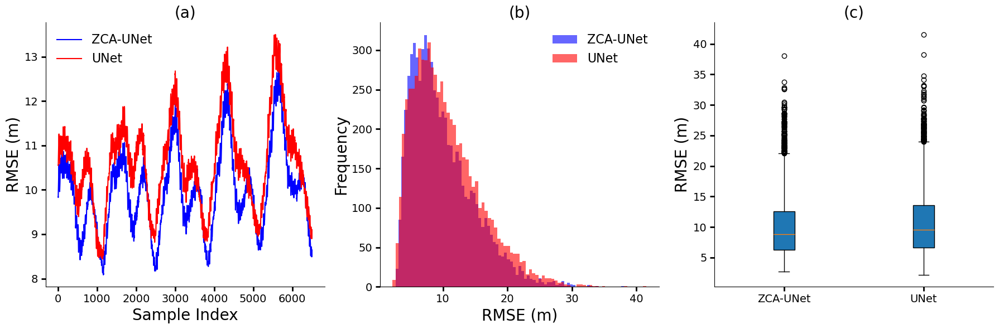


Statistics:
ZCA-UNet Mean: 9.94 m
UNet Mean: 10.58 m
ZCA-UNet Std: 4.81 m
UNet Std: 5.19 m
ZCA-UNet Median: 8.83 m
UNet Median: 9.56 m
t-test: t=-17.062, p=6.295e-64
Improvement: 6.01%


In [8]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import os

# Calculate RMSE for each sample for both models
def calculate_rmse(pred, true):
    # Compute RMSE for each sample across i,j dimensions
    return np.sqrt(((pred - true)**2).mean(dim=['i', 'j']))

# Calculate RMSE for each sample for both models
rmse_zca = calculate_rmse(ubm_pre_zca_clean, ubm_true_clean)
rmse_unet = calculate_rmse(ubm_pre_unet_clean, ubm_true_clean)

# Convert to numpy arrays for easier plotting
rmse_zca_np = rmse_zca.values
rmse_unet_np = rmse_unet.values

# Convert to meters based on 1.5km grid size (multiply by 1500)
rmse_zca_np = rmse_zca_np * 1500
rmse_unet_np = rmse_unet_np * 1500

# Calculate statistics (now in meters)
zca_mean = rmse_zca_np.mean()
unet_mean = rmse_unet_np.mean()
zca_std = rmse_zca_np.std()
unet_std = rmse_unet_np.std()
zca_median = np.median(rmse_zca_np)
unet_median = np.median(rmse_unet_np)
improvement = (unet_mean - zca_mean) / unet_mean * 100
t_stat, p_value = stats.ttest_rel(rmse_zca_np, rmse_unet_np)

# Apply smoothing with a moving average window
def smooth(data, window_size=100):
    window = np.ones(window_size) / window_size
    return np.convolve(data, window, mode='valid')

# Create smoothed versions of the data
window_size = 200
rmse_zca_smooth = smooth(rmse_zca_np, window_size)
rmse_unet_smooth = smooth(rmse_unet_np, window_size)

# Create a figure with 1x3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Remove frames from all subplots
for ax in axes:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

# 1. Smoothed line plot - RMSE by sample
x_indices = np.arange(len(rmse_zca_smooth))
axes[0].plot(x_indices, rmse_zca_smooth, label='ZCA-UNet', color='blue', linewidth=1.5)
axes[0].plot(x_indices, rmse_unet_smooth, label='UNet', color='red', linewidth=1.5)
axes[0].set_xlabel('Sample Index', fontsize=20)
axes[0].set_ylabel('RMSE (m)', fontsize=20)
axes[0].set_title('(a)', fontsize=20)
axes[0].legend(fontsize=16, frameon=False)  # Increased legend text size, removed frame

# Increase tick size and value size
axes[0].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
axes[0].tick_params(axis='both', which='minor', width=1.5, length=4)

# 2. Histogram of RMSE distributions with log x-axis
axes[1].hist(rmse_zca_np, bins=80, alpha=0.6, label='ZCA-UNet', color='blue')
axes[1].hist(rmse_unet_np, bins=80, alpha=0.6, label='UNet', color='red')
axes[1].set_xlabel('RMSE (m)', fontsize=20)
axes[1].set_ylabel('Frequency', fontsize=20)
axes[1].set_title('(b)', fontsize=20)
axes[1].legend(fontsize=16, frameon=False)  # Increased legend text size, removed frame

# Increase tick size and value size 
axes[1].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
axes[1].tick_params(axis='both', which='minor', width=1.5, length=4)

# 3. Box plot with statistics
rmse_data = [rmse_zca_np, rmse_unet_np]
axes[2].boxplot(rmse_data, labels=['ZCA-UNet', 'UNet'], patch_artist=True)
axes[2].set_ylabel('RMSE (m)', fontsize=20)
axes[2].set_title('(c)', fontsize=20)
axes[2].set_xticklabels(['ZCA-UNet', 'UNet'], fontsize=20)

# Increase tick size and value size
axes[2].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
axes[2].tick_params(axis='both', which='minor', width=1.5, length=4)

plt.tight_layout()

# Save the figure to the specified directory
save_path = '/home/jovyan/GRL/figures/rmse_comparison.pdf'
os.makedirs(os.path.dirname(save_path), exist_ok=True)
plt.savefig(save_path, dpi=300, bbox_inches='tight')

plt.show()

# Print statistics after showing the plot
print("\nStatistics:")
print(f"ZCA-UNet Mean: {zca_mean:.2f} m")
print(f"UNet Mean: {unet_mean:.2f} m")
print(f"ZCA-UNet Std: {zca_std:.2f} m")
print(f"UNet Std: {unet_std:.2f} m")
print(f"ZCA-UNet Median: {zca_median:.2f} m")
print(f"UNet Median: {unet_median:.2f} m")
print(f"t-test: t={t_stat:.3f}, p={p_value:.3e}")
print(f"Improvement: {improvement:.2f}%")

## BM, UBM, Gradient

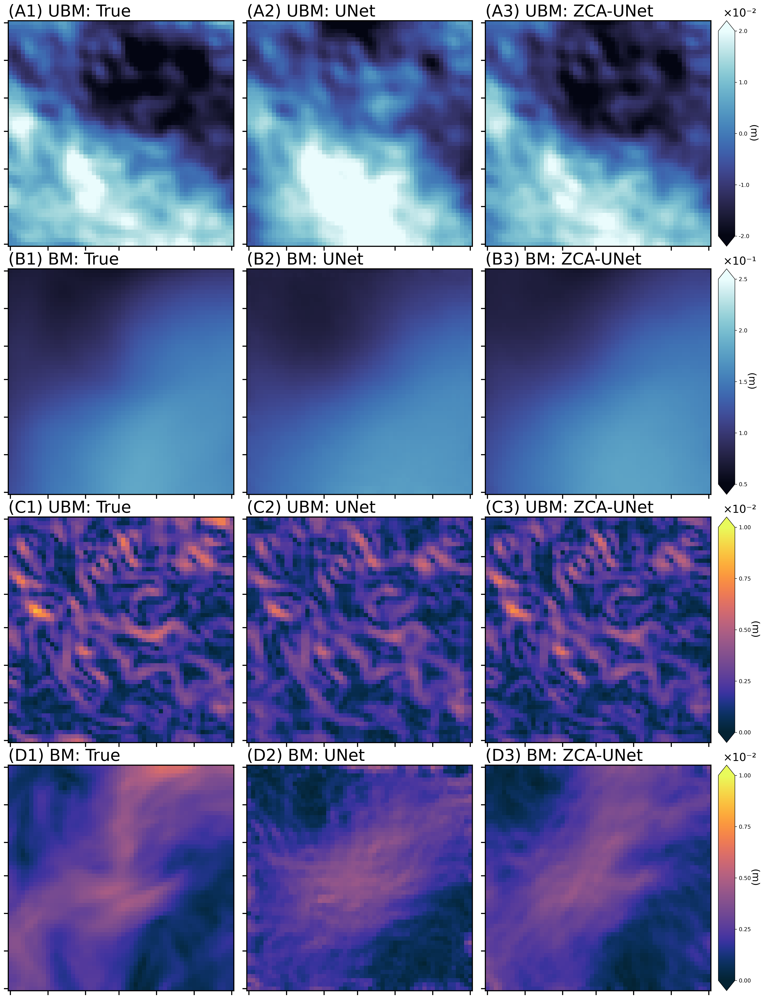

In [9]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import xarray as xr
from matplotlib import gridspec
from matplotlib.colors import Normalize
import cmocean.cm as cmo  

# Set DPI parameters 
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

# Set title parameters
title_fontsize = 30 
title_pad = 8

# ----------------------
# Define plotting parameters using ranges from reference
# ----------------------
vmin_ubm, vmax_ubm = -0.02, 0.02  # Using SSH range from reference
vmin_bm, vmax_bm = 0.05, 0.25    # Using SSH range from reference
vmin_grad, vmax_grad = 0.0, 0.01  # Using gradient range from reference

# Tick setup following the reference pattern
ticks_ubm = np.array([-2.0, -1.0, 0.0, 1.0, 2.0])
ticks_bm = np.array([0.5, 1.0, 1.5, 2.0, 2.5])  
ticks_grad = np.array([0.00, 0.25, 0.50, 0.75, 1.00])

ticks_ubm_data = ticks_ubm / 100   # Data values
ticks_bm_data = ticks_bm / 10     # Data values
ticks_grad_data = ticks_grad / 100  # Data values

# Create the size of your arrays (assuming they are square)
# **CHANGED TO BEST SAMPLE**
size = best_ubm_true_sample.shape[0]
i = np.arange(size)
j = np.arange(size)

# Convert numpy arrays to xarray DataArrays
# **CHANGED TO BEST SAMPLE**
# UBM arrays
ubm_true_da = xr.DataArray(best_ubm_true_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (True)')
ubm_unet_da = xr.DataArray(best_ubm_pre_unet_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (UNet)')
ubm_zca_da = xr.DataArray(best_ubm_pre_zca_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (ZCA-UNet)')

# BM arrays
bm_true_da = xr.DataArray(best_bm_true_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (True)')
bm_unet_da = xr.DataArray(best_bm_pre_unet_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (UNet)')
bm_zca_da = xr.DataArray(best_bm_pre_zca_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (ZCA-UNet)')

# BM Gradient arrays
bm_grad_true_da = xr.DataArray(best_bm_true_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (True)')
bm_grad_unet_da = xr.DataArray(best_bm_pre_unet_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (UNet)')
bm_grad_zca_da = xr.DataArray(best_bm_pre_zca_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (ZCA-UNet)')

# UBM Gradient arrays
ubm_grad_true_da = xr.DataArray(best_ubm_true_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (True)')
ubm_grad_unet_da = xr.DataArray(best_ubm_pre_unet_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (UNet)')
ubm_grad_zca_da = xr.DataArray(best_ubm_pre_zca_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (ZCA-UNet)')

# Create figure with subplots - 4 ROWS
fig = plt.figure(figsize=(24, 32))  # Increased to accommodate 4 rows

# Create a grid with proper alignment
gs = gridspec.GridSpec(4, 4,  # Changed to 4 rows
                      width_ratios=[1, 1, 1, 0.07],  
                      height_ratios=[1, 1, 1, 1],  # Added 4th row
                      wspace=0.01, hspace=0.1)

# Define colormaps using cmocean
cmap_ubm = cmo.ice
cmap_bm = cmo.ice
cmap_grad = cmo.thermal

# Helper function to format the axes with ticks and boundary boxes
def format_ax(ax, title):
    # For a 54x54 grid where each pixel is 1.5km
    size = 54
    
    # Calculate tick positions in pixel units - 6 sections of 9 pixels each
    tick_positions = np.linspace(0, size-1, 7)  # 7 points to create 6 sections
    tick_positions = np.round(tick_positions).astype(int)  # Round to integers
    
    # Set ticks
    ax.set_xticks(tick_positions)
    ax.set_yticks(tick_positions)
    
    # Remove tick labels (keeping only the tick marks)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    
    # Make ticks bolder and larger
    ax.tick_params(axis='both', which='major', length=8, width=2, color='black')
    
    # Set title
    ax.set_title(title, fontsize=title_fontsize, pad=title_pad, loc='left')
    
    # Add boundary box by making all spines visible and formatting them
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_linewidth(2)  # Make the box border thicker
        spine.set_color('black')  # Set the color to black
    
    # Remove axis labels since we're not showing the numbers
    ax.set_xlabel('')
    ax.set_ylabel('')

# Row 1: UBM Plots
ax1 = fig.add_subplot(gs[0, 0])
im1 = ax1.imshow(best_ubm_true_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax1, '(A1) UBM: True')

ax2 = fig.add_subplot(gs[0, 1])
im2 = ax2.imshow(best_ubm_pre_unet_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax2, '(A2) UBM: UNet')

ax3 = fig.add_subplot(gs[0, 2])
im3 = ax3.imshow(best_ubm_pre_zca_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax3, '(A3) UBM: ZCA-UNet')

# Create colorbar for UBM row
cax1 = fig.add_subplot(gs[0, 3])
cbar1 = plt.colorbar(im1, cax=cax1, extend='both', ticks=ticks_ubm_data)

# Style colorbar following reference
cax1.axis('auto')
pos1 = cax1.get_position()
new_pos1 = [pos1.x0, pos1.y0 + pos1.height * 0, pos1.width, pos1.height * 1]
cax1.set_position(new_pos1)
cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar1.ax.set_yticklabels([f'{x:.1f}' for x in ticks_ubm])
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')
cbar1.ax.text(1.3, 1.06, '×10⁻²', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 2: BM Plots
ax4 = fig.add_subplot(gs[1, 0])
im4 = ax4.imshow(best_bm_true_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax4, '(B1) BM: True')

ax5 = fig.add_subplot(gs[1, 1])
im5 = ax5.imshow(best_bm_pre_unet_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax5, '(B2) BM: UNet')

ax6 = fig.add_subplot(gs[1, 2])
im6 = ax6.imshow(best_bm_pre_zca_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax6, '(B3) BM: ZCA-UNet')

# Create colorbar for BM row
cax2 = fig.add_subplot(gs[1, 3])
cbar2 = plt.colorbar(im4, cax=cax2, extend='both', ticks=ticks_bm_data)

# Style colorbar following reference
cax2.axis('auto')
pos2 = cax2.get_position()
new_pos2 = [pos2.x0, pos2.y0 + pos2.height * 0, pos2.width, pos2.height * 1]
cax2.set_position(new_pos2)
cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar2.ax.set_yticklabels([f'{x:.1f}' for x in ticks_bm])
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')
cbar2.ax.text(1.3, 1.06, '×10⁻¹', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 3: UBM Gradient Plots (NEW)
ax7 = fig.add_subplot(gs[2, 0])
im7 = ax7.imshow(best_ubm_true_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax7, '(C1) UBM: True')

ax8 = fig.add_subplot(gs[2, 1])
im8 = ax8.imshow(best_ubm_pre_unet_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax8, '(C2) UBM: UNet')

ax9 = fig.add_subplot(gs[2, 2])
im9 = ax9.imshow(best_ubm_pre_zca_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax9, '(C3) UBM: ZCA-UNet')

# Create colorbar for UBM Gradient row
cax3 = fig.add_subplot(gs[2, 3])
cbar3 = plt.colorbar(im7, cax=cax3, extend='both', ticks=ticks_grad_data)

# Style colorbar following reference
cax3.axis('auto')
pos3 = cax3.get_position()
new_pos3 = [pos3.x0, pos3.y0 - pos3.height * 0.00, pos3.width, pos3.height * 1.0]
cax3.set_position(new_pos3)
cbar3.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar3.ax.set_yticklabels([f'{x:.2f}' for x in ticks_grad])
cbar3.ax.yaxis.tick_right()
cbar3.ax.yaxis.set_label_position('right')
cbar3.ax.text(1.3, 1.06, '×10⁻²', transform=cbar3.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 4: BM Gradient Plots
ax10 = fig.add_subplot(gs[3, 0])
im10 = ax10.imshow(best_bm_true_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax10, '(D1) BM: True')

ax11 = fig.add_subplot(gs[3, 1])
im11 = ax11.imshow(best_bm_pre_unet_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax11, '(D2) BM: UNet')

ax12 = fig.add_subplot(gs[3, 2])
im12 = ax12.imshow(best_bm_pre_zca_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax12, '(D3) BM: ZCA-UNet')

# Create colorbar for BM Gradient row
cax4 = fig.add_subplot(gs[3, 3])
cbar4 = plt.colorbar(im10, cax=cax4, extend='both', ticks=ticks_grad_data)

# Style colorbar following reference
cax4.axis('auto')
pos4 = cax4.get_position()
new_pos4 = [pos4.x0, pos4.y0 + pos4.height * 0.0, pos4.width, pos4.height * 1]
cax4.set_position(new_pos4)
cbar4.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar4.ax.set_yticklabels([f'{x:.2f}' for x in ticks_grad])
cbar4.ax.yaxis.tick_right()
cbar4.ax.yaxis.set_label_position('right')
cbar4.ax.text(1.3, 1.06, '×10⁻²', transform=cbar4.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Save figure
plt.savefig('/home/jovyan/GRL/figures/best_sample_bm_ubm_4rows.pdf', bbox_inches='tight', dpi=300, transparent=True)
plt.show()

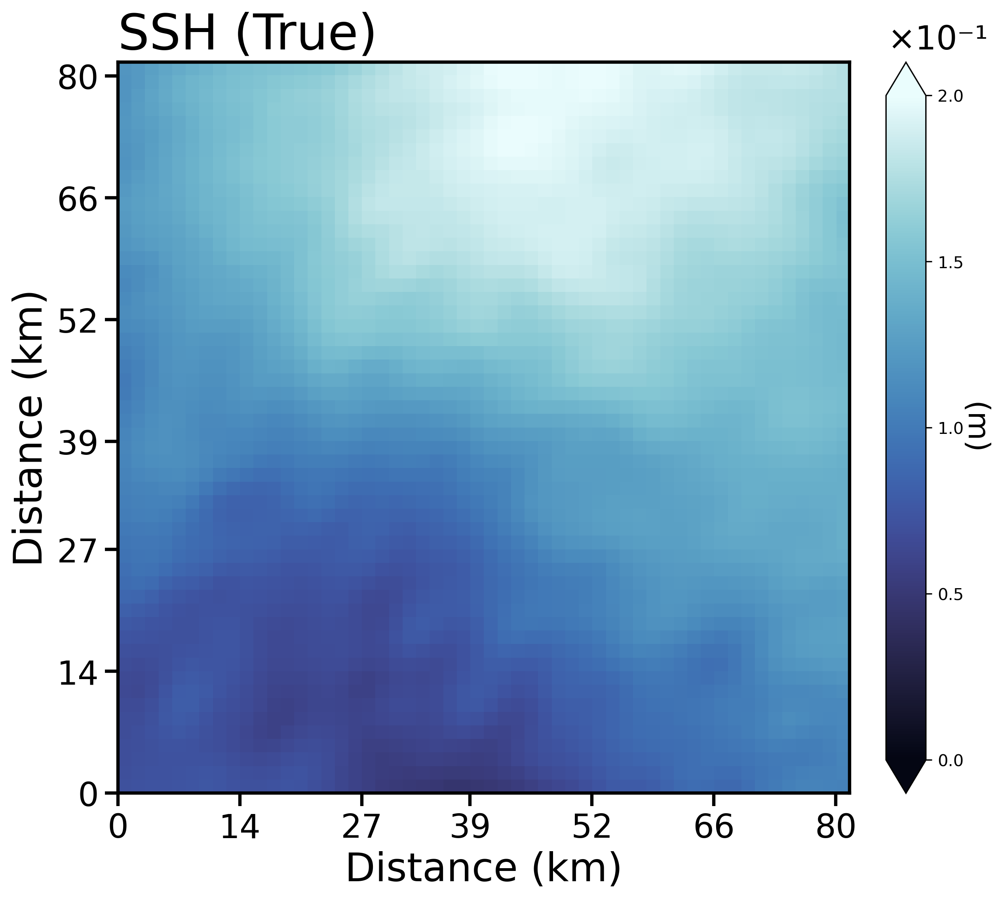

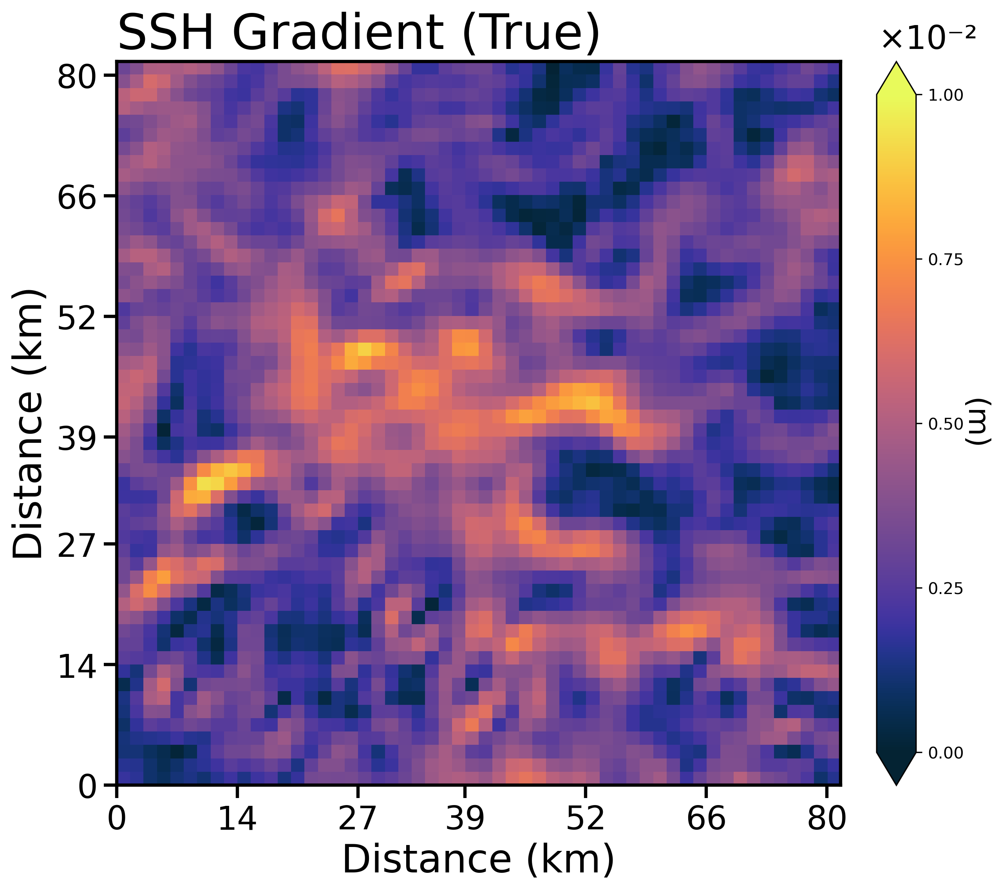

In [10]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
from matplotlib import gridspec
import cmocean.cm as cmo  # Import cmocean for the ice and thermal colormaps

# ── General plotting parameters ─────────────────────────────
plt.rcParams['figure.dpi']   = 300
plt.rcParams['savefig.dpi']  = 300
title_fontsize = 30
title_pad      = 8

# ── Data limits and tick locations ──────────────────────────
vmin_ssh, vmax_ssh   = 0.0, 0.20
vmin_grad, vmax_grad = 0.0, 0.01

# Tick values displayed should be the actual values divided by 10^-1 and 10^-2
ticks_ssh = np.array([0.0, 0.5, 1.0, 1.5, 2.0])
ticks_grad = np.array([0.00, 0.25, 0.50, 0.75, 1.00])  # Actual values * 10^2
ticks_ssh_data = ticks_ssh / 10  # Data values
ticks_grad_data = ticks_grad / 100  # Data values

# Helper function to format axes with ticks and boundary boxes
def format_ax(ax, title):
    # For a 54x54 grid where each pixel is 1.5km
    size = 54
    
    # Calculate tick positions in pixel units - 6 sections of 9 pixels each
    tick_positions = np.linspace(0, size-1, 7)  # 7 points to create 6 sections
    tick_positions = np.round(tick_positions).astype(int)  # Round to integers
    
    # Calculate km values (each pixel = 1.5km)
    km_ticks = tick_positions * 1.5
    
    # Set ticks
    ax.set_xticks(tick_positions)
    ax.set_yticks(tick_positions)
    
    # Add km labels
    ax.set_xticklabels([f'{x:.0f}' for x in km_ticks])
    ax.set_yticklabels([f'{x:.0f}' for x in km_ticks])
    
    # Make ticks and labels more visible
    ax.tick_params(axis='both', which='major', length=8, width=2, labelsize=20)
    
    # Set title
    ax.set_title(title, fontsize=title_fontsize, pad=title_pad, loc='left')
    
    # Add boundary box with linewidth=2
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_linewidth(2)  # Make the box border thicker
        spine.set_color('black')  # Set the color to black
    
    # Add km labels to axes
    ax.set_xlabel('Distance (km)', fontsize=24)
    ax.set_ylabel('Distance (km)', fontsize=24)

# ── SSH Plot ─────────────────────────────────────────────────
fig1 = plt.figure(figsize=(10, 8))  # Made figure wider to accommodate km labels
gs1 = gridspec.GridSpec(1, 2, width_ratios=[1, 0.05], wspace=0.2)  
ax1 = fig1.add_subplot(gs1[0, 0])
im1 = ax1.imshow(best_ssh_sample, cmap=cmo.ice,  # Changed colormap to ice
                 vmin=vmin_ssh, vmax=vmax_ssh,
                 origin='lower',  # Set origin to lower left (0,0)
                 extent=[0, 54, 0, 54])  

# Format the axes with the helper function
format_ax(ax1, 'SSH (True)')

cax1 = fig1.add_subplot(gs1[0, 1])
cbar1 = fig1.colorbar(im1, cax=cax1, extend='both', ticks=ticks_ssh_data)



# Shrink colorbar height by 20%
cax1.axis('auto')
pos1 = cax1.get_position()
new_pos1 = [pos1.x0 - pos1.width * 2, pos1.y0 + pos1.height * 0.0, pos1.width, pos1.height * 1]
cax1.set_position(new_pos1)
cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)

# Style colorbar with scaled values
cbar1.ax.set_yticklabels([f'{x:.1f}' for x in ticks_ssh])

# Make colorbar text appear on the right side
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')

# Add the scientific notation indicator with better spacing
cbar1.ax.text(1.3, 1.06, '×10⁻¹', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

plt.savefig('/home/jovyan/GRL/figures/ssh_clean_fixed.pdf',
            bbox_inches='tight', dpi=300, transparent=True)
plt.show()

# ── SSH Gradient Plot ─────────────────────────────────────────
fig2 = plt.figure(figsize=(10, 8))  # Made figure wider to accommodate km labels
gs2 = gridspec.GridSpec(1, 2, width_ratios=[1, 0.05], wspace=0.2)  
ax2 = fig2.add_subplot(gs2[0, 0])
im2 = ax2.imshow(best_ssh_grad_sample, cmap=cmo.thermal,  # Changed colormap to thermal
                 vmin=vmin_grad, vmax=vmax_grad,
                 origin='lower',  # Set origin to lower left (0,0)
                 extent=[0, 54, 0, 54])  

# Format the axes with the helper function
format_ax(ax2, 'SSH Gradient (True)')

cax2 = fig2.add_subplot(gs2[0, 1])
cbar2 = fig2.colorbar(im2, cax=cax2, extend='both', ticks=ticks_grad_data)


cax2.axis('auto')
pos2 = cax2.get_position()
new_pos2 = [pos2.x0 - pos2.width * 2, pos2.y0 + pos2.height * 0.0, pos2.width, pos2.height * 1]
cax2.set_position(new_pos2)
cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)

# Style colorbar with scaled values
cbar2.ax.set_yticklabels([f'{x:.2f}' for x in ticks_grad])

# Make colorbar text appear on the right side
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')

# Add the scientific notation indicator with better spacing
cbar2.ax.text(1.3, 1.06, '×10⁻²', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

plt.savefig('/home/jovyan/GRL/figures/ssh_gradient_clean_fixed.pdf',
            bbox_inches='tight', dpi=300, transparent=True)
plt.show()

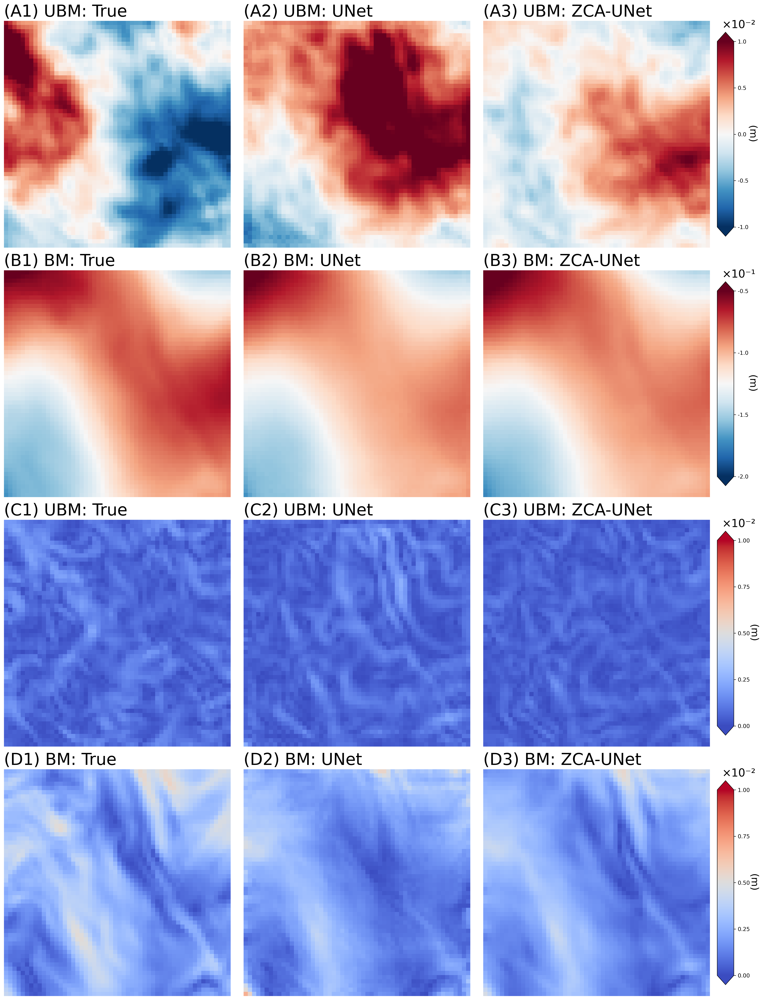

In [11]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import xarray as xr
from matplotlib import gridspec
from matplotlib.colors import Normalize

# Set DPI parameters 
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

# Set title parameters
title_fontsize = 30 
title_pad = 8

# ----------------------
# Define plotting parameters using ranges from reference
# ----------------------
vmin_ubm, vmax_ubm = -0.01, 0.01
vmin_bm, vmax_bm = -0.2, -0.05
vmin_grad, vmax_grad = 0, 0.01

# Tick setup following the reference pattern
ticks_ubm = np.array([-1.0, -0.5, 0.0, 0.5, 1.0])
ticks_bm = np.array([-2.0, -1.5, -1.0, -0.5])  
ticks_grad = np.array([0.00, 0.25, 0.50, 0.75, 1.00])

ticks_ubm_data = ticks_ubm / 100   # Data values
ticks_bm_data = ticks_bm / 10     # Data values
ticks_grad_data = ticks_grad / 100  # Data values

# Create the size of your arrays (assuming they are square)
# **CHANGED TO worst SAMPLE**
size = worst_ubm_true_sample.shape[0]
i = np.arange(size)
j = np.arange(size)

# Convert numpy arrays to xarray DataArrays
# **CHANGED TO worst SAMPLE**
# UBM arrays
ubm_true_da = xr.DataArray(worst_ubm_true_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (True)')
ubm_unet_da = xr.DataArray(worst_ubm_pre_unet_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (UNet)')
ubm_zca_da = xr.DataArray(worst_ubm_pre_zca_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM (ZCA-UNet)')

# BM arrays
bm_true_da = xr.DataArray(worst_bm_true_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (True)')
bm_unet_da = xr.DataArray(worst_bm_pre_unet_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (UNet)')
bm_zca_da = xr.DataArray(worst_bm_pre_zca_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM (ZCA-UNet)')

# BM Gradient arrays
bm_grad_true_da = xr.DataArray(worst_bm_true_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (True)')
bm_grad_unet_da = xr.DataArray(worst_bm_pre_unet_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (UNet)')
bm_grad_zca_da = xr.DataArray(worst_bm_pre_zca_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='BM Grad (ZCA-UNet)')

# UBM Gradient arrays
ubm_grad_true_da = xr.DataArray(worst_ubm_true_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (True)')
ubm_grad_unet_da = xr.DataArray(worst_ubm_pre_unet_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (UNet)')
ubm_grad_zca_da = xr.DataArray(worst_ubm_pre_zca_grad_sample, dims=('i', 'j'), coords={'i': i, 'j': j}, name='UBM Grad (ZCA-UNet)')

# Create figure with subplots - 4 ROWS
fig = plt.figure(figsize=(24, 32))  # Increased to accommodate 4 rows

# Create a grid with proper alignment
gs = gridspec.GridSpec(4, 4,  # Changed to 4 rows
                      width_ratios=[1, 1, 1, 0.07],  
                      height_ratios=[1, 1, 1, 1],  # Added 4th row
                      wspace=0.01, hspace=0.1)

# Define colormaps as in reference
cmap_ubm = plt.cm.RdBu_r    
cmap_bm = plt.cm.RdBu_r       
cmap_grad = plt.cm.coolwarm 

# Helper function to format the axes
def format_ax(ax, title):
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(title, fontsize=title_fontsize, pad=title_pad, loc='left')
    # Remove boxes as in reference
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

# Row 1: UBM Plots
ax1 = fig.add_subplot(gs[0, 0])
im1 = ax1.imshow(worst_ubm_true_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax1, '(A1) UBM: True')

ax2 = fig.add_subplot(gs[0, 1])
im2 = ax2.imshow(worst_ubm_pre_unet_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax2, '(A2) UBM: UNet')

ax3 = fig.add_subplot(gs[0, 2])
im3 = ax3.imshow(worst_ubm_pre_zca_sample, cmap=cmap_ubm, vmin=vmin_ubm, vmax=vmax_ubm)
format_ax(ax3, '(A3) UBM: ZCA-UNet')

# Create colorbar for UBM row
cax1 = fig.add_subplot(gs[0, 3])
cbar1 = plt.colorbar(im1, cax=cax1, extend='both', ticks=ticks_ubm_data)

# Style colorbar following reference
cax1.axis('auto')
pos1 = cax1.get_position()
new_pos1 = [pos1.x0, pos1.y0 + pos1.height * 0.05, pos1.width, pos1.height * 0.9]
cax1.set_position(new_pos1)
cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar1.ax.set_yticklabels([f'{x:.1f}' for x in ticks_ubm])
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')
cbar1.ax.text(1.3, 1.06, '×10⁻²', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 2: BM Plots
ax4 = fig.add_subplot(gs[1, 0])
im4 = ax4.imshow(worst_bm_true_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax4, '(B1) BM: True')

ax5 = fig.add_subplot(gs[1, 1])
im5 = ax5.imshow(worst_bm_pre_unet_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax5, '(B2) BM: UNet')

ax6 = fig.add_subplot(gs[1, 2])
im6 = ax6.imshow(worst_bm_pre_zca_sample, cmap=cmap_bm, vmin=vmin_bm, vmax=vmax_bm)
format_ax(ax6, '(B3) BM: ZCA-UNet')

# Create colorbar for BM row
cax2 = fig.add_subplot(gs[1, 3])
cbar2 = plt.colorbar(im4, cax=cax2, extend='both', ticks=ticks_bm_data)

# Style colorbar following reference
cax2.axis('auto')
pos2 = cax2.get_position()
new_pos2 = [pos2.x0, pos2.y0 + pos2.height * 0.05, pos2.width, pos2.height * 0.9]
cax2.set_position(new_pos2)
cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar2.ax.set_yticklabels([f'{x:.1f}' for x in ticks_bm])
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')
cbar2.ax.text(1.3, 1.06, '×10⁻¹', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 3: UBM Gradient Plots (NEW)
ax7 = fig.add_subplot(gs[2, 0])
im7 = ax7.imshow(worst_ubm_true_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax7, '(C1) UBM: True')

ax8 = fig.add_subplot(gs[2, 1])
im8 = ax8.imshow(worst_ubm_pre_unet_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax8, '(C2) UBM: UNet')

ax9 = fig.add_subplot(gs[2, 2])
im9 = ax9.imshow(worst_ubm_pre_zca_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax9, '(C3) UBM: ZCA-UNet')

# Create colorbar for UBM Gradient row
cax3 = fig.add_subplot(gs[2, 3])
cbar3 = plt.colorbar(im7, cax=cax3, extend='both', ticks=ticks_grad_data)

# Style colorbar following reference
cax3.axis('auto')
pos3 = cax3.get_position()
new_pos3 = [pos3.x0, pos3.y0 + pos3.height * 0.05, pos3.width, pos3.height * 0.9]
cax3.set_position(new_pos3)
cbar3.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar3.ax.set_yticklabels([f'{x:.2f}' for x in ticks_grad])
cbar3.ax.yaxis.tick_right()
cbar3.ax.yaxis.set_label_position('right')
cbar3.ax.text(1.3, 1.06, '×10⁻²', transform=cbar3.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 4: BM Gradient Plots
ax10 = fig.add_subplot(gs[3, 0])
im10 = ax10.imshow(worst_bm_true_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax10, '(D1) BM: True')

ax11 = fig.add_subplot(gs[3, 1])
im11 = ax11.imshow(worst_bm_pre_unet_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax11, '(D2) BM: UNet')

ax12 = fig.add_subplot(gs[3, 2])
im12 = ax12.imshow(worst_bm_pre_zca_grad_sample, cmap=cmap_grad, vmin=vmin_grad, vmax=vmax_grad)
format_ax(ax12, '(D3) BM: ZCA-UNet')

# Create colorbar for BM Gradient row
cax4 = fig.add_subplot(gs[3, 3])
cbar4 = plt.colorbar(im10, cax=cax4, extend='both', ticks=ticks_grad_data)

# Style colorbar following reference
cax4.axis('auto')
pos4 = cax4.get_position()
new_pos4 = [pos4.x0, pos4.y0 + pos4.height * 0.05, pos4.width, pos4.height * 0.9]
cax4.set_position(new_pos4)
cbar4.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)
cbar4.ax.set_yticklabels([f'{x:.2f}' for x in ticks_grad])
cbar4.ax.yaxis.tick_right()
cbar4.ax.yaxis.set_label_position('right')
cbar4.ax.text(1.3, 1.06, '×10⁻²', transform=cbar4.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Save figure
plt.savefig('/home/jovyan/GRL/figures/worst_sample_bm_ubm_4rows.pdf', bbox_inches='tight', dpi=300, transparent=True)
plt.show()

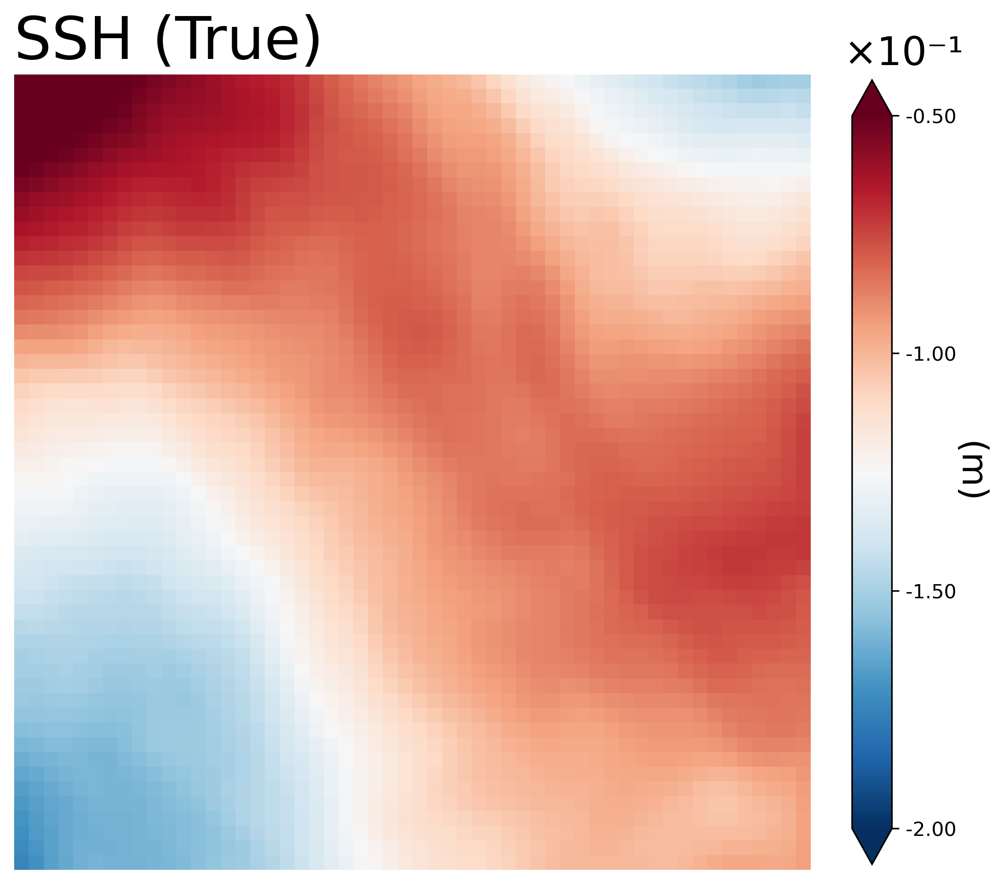

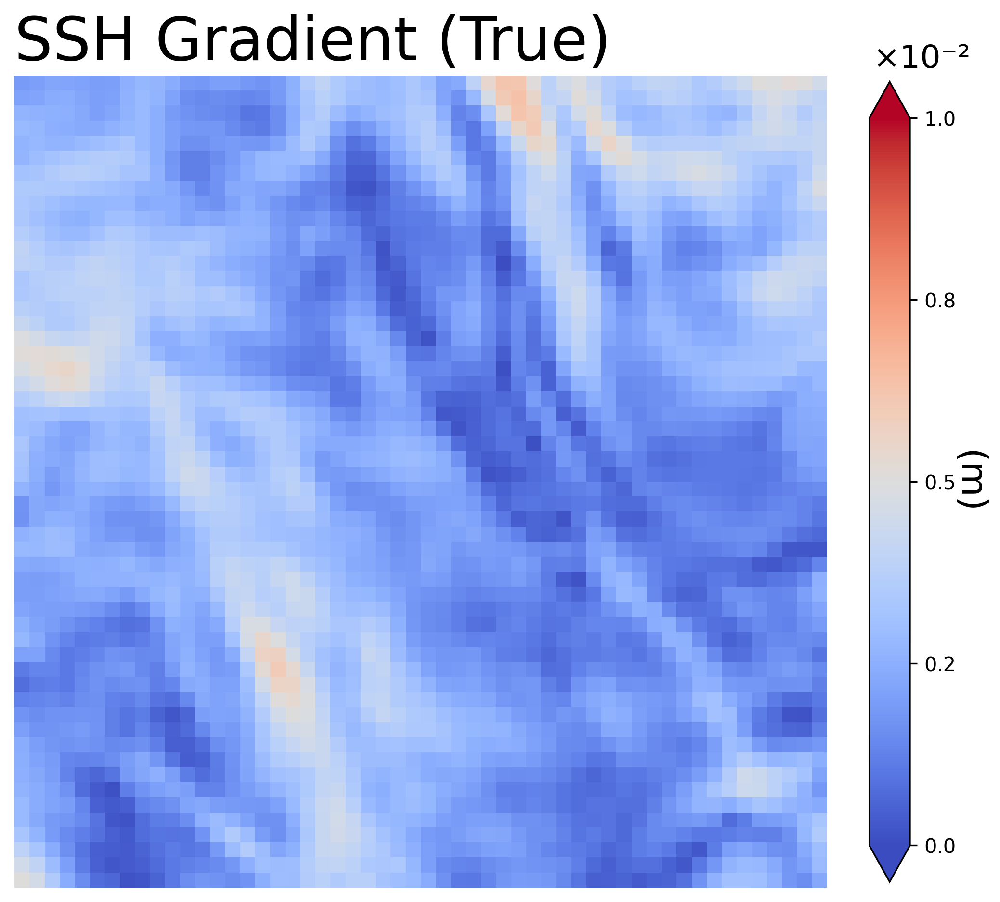

In [12]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
from matplotlib import gridspec

# ── General plotting parameters ─────────────────────────────
plt.rcParams['figure.dpi']   = 300
plt.rcParams['savefig.dpi']  = 300
title_fontsize = 30
title_pad      = 8

# ── Data limits and tick locations ──────────────────────────
vmin_ssh, vmax_ssh   = -0.2, -0.05
vmin_grad, vmax_grad = 0, 0.01

# Tick values displayed should be the actual values divided by 10^-1 and 10^-2
ticks_ssh = np.array([-2.0, -1.5, -1.0, -0.5]) 
ticks_grad = np.array([0.00, 0.25, 0.50, 0.75, 1.00])
ticks_ssh_data = ticks_ssh / 10 # Data values
ticks_grad_data = ticks_grad / 100  # Data values

# ── SSH Plot ─────────────────────────────────────────────────
fig1 = plt.figure(figsize=(8, 8))
gs1 = gridspec.GridSpec(1, 2, width_ratios=[1, 0.05], wspace=0.1)  
ax1 = fig1.add_subplot(gs1[0, 0])
im1 = ax1.imshow(worst_ssh_sample, cmap='RdBu_r',
                 vmin=vmin_ssh, vmax=vmax_ssh)
ax1.set_xticks([]); ax1.set_yticks([])
ax1.set_title('SSH (True)',
              fontsize=title_fontsize,
              pad=title_pad,
              loc='left')

# Remove the box around the image
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)

cax1 = fig1.add_subplot(gs1[0, 1])
cbar1 = fig1.colorbar(im1, cax=cax1, extend='both', ticks=ticks_ssh_data)

# Shrink colorbar height by 20%
cax1.axis('auto')
pos1 = cax1.get_position()
new_pos1 = [pos1.x0, pos1.y0 + pos1.height * 0.05, pos1.width, pos1.height * 0.9]
cax1.set_position(new_pos1)

cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)

# Style colorbar with scaled values
cbar1.ax.set_yticklabels([f'{x:.2f}' for x in ticks_ssh])

# Make colorbar text appear on the right side
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')

# Add the scientific notation indicator with better spacing
cbar1.ax.text(1.3, 1.06, '×10⁻¹', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

plt.savefig('/home/jovyan/GRL/figures/ssh_worst.pdf',
            bbox_inches='tight', dpi=300, transparent=True)
plt.show()

# ── SSH Gradient Plot ─────────────────────────────────────────
fig2 = plt.figure(figsize=(8, 8))
gs2 = gridspec.GridSpec(1, 2, width_ratios=[1, 0.05], wspace=0.1)  
ax2 = fig2.add_subplot(gs2[0, 0])
im2 = ax2.imshow(worst_ssh_grad_sample, cmap='coolwarm',
                 vmin=vmin_grad, vmax=vmax_grad)
ax2.set_xticks([]); ax2.set_yticks([])
ax2.set_title('SSH Gradient (True)',
              fontsize=title_fontsize,
              pad=title_pad,
              loc='left')

# Remove the box around the image
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['bottom'].set_visible(False)
ax2.spines['left'].set_visible(False)

cax2 = fig2.add_subplot(gs2[0, 1])
cbar2 = fig2.colorbar(im2, cax=cax2, extend='both', ticks=ticks_grad_data)

# Shrink colorbar height by 20%
cax2.axis('auto')
pos2 = cax2.get_position()
new_pos2 = [pos2.x0, pos2.y0 + pos2.height * 0.05, pos2.width, pos2.height * 0.9]
cax2.set_position(new_pos2)

cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=18)

# Style colorbar with scaled values
cbar2.ax.set_yticklabels([f'{x:.1f}' for x in ticks_grad])

# Make colorbar text appear on the right side
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')

# Add the scientific notation indicator with better spacing
cbar2.ax.text(1.3, 1.06, '×10⁻²', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=16)

plt.savefig('/home/jovyan/GRL/figures/ssh_grad_worst.pdf',
            bbox_inches='tight', dpi=300, transparent=True)
plt.show()

## PDF

Figure saved to /home/jovyan/GRL/figures/ubm_uncertainty_distribution_subplots.pdf


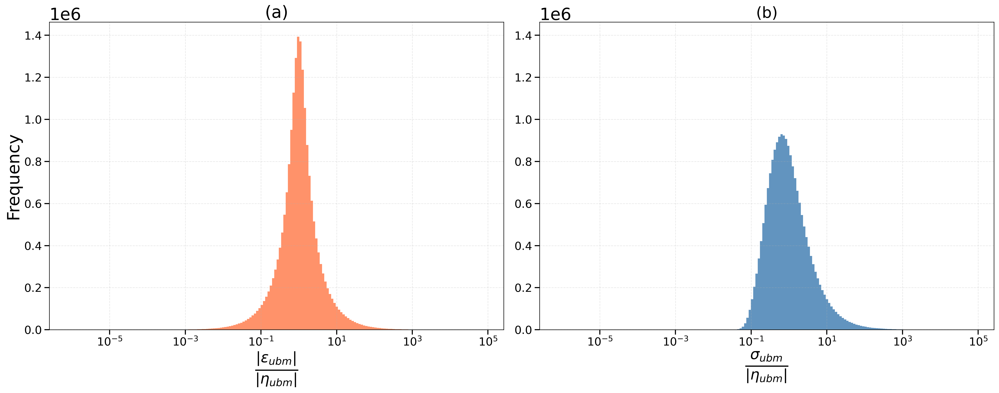

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Set up directory for saving
save_dir = '/home/jovyan/GRL/figures/'

# Increase global font size
plt.rcParams.update({
    'font.size': 14,
    'axes.titlesize': 22,
    'axes.labelsize': 20,
    'xtick.labelsize': 24,
    'ytick.labelsize': 24,
    'legend.fontsize': 16
})

# Calculate normalized uncertainty (pixel-wise)
eps = 1e-7  # Small epsilon to avoid division by zero
ubm_ratio = ubm_uncertainty_clean / (np.abs(ubm_true_clean) + eps)

# Calculate absolute relative error
abs_rel_error = np.abs(ubm_pre_zca_clean - ubm_true_clean) / (np.abs(ubm_true_clean) + eps)

# Create figure with subplots with higher DPI
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8), dpi=300)

# Prepare data for both panels first to find common ranges
# Flatten and clean data1
flat_data1 = ubm_ratio.values.flatten()
flat_data1 = flat_data1[np.isfinite(flat_data1)]
flat_data1 = flat_data1[flat_data1 > 0]

# Flatten and clean data2
flat_data2 = abs_rel_error.values.flatten()
flat_data2 = flat_data2[np.isfinite(flat_data2)]
flat_data2 = flat_data2[flat_data2 > 0]

# Find common x-axis range
x_min = min(flat_data1.min(), flat_data2.min())
x_max = max(flat_data1.max(), flat_data2.max())

# Choose logarithmically spaced bin edges with common range
bins = 200
bin_edges = np.logspace(np.log10(x_min), np.log10(x_max), bins + 1)

# First panel: Absolute relative error (switched position)
# Plot histogram with logarithmic binning
ax1.hist(flat_data2, bins=bin_edges, color='coral', alpha=0.85)
ax1.set_xscale('log')
ax1.set_xlabel(r"$\frac{|\epsilon_{ubm}|}{|\eta_{ubm}|}$", fontsize=30)
ax1.set_ylabel('Frequency', fontsize=24)
ax1.set_title('(a)', fontsize=24)
ax1.tick_params(axis='both', which='major', labelsize=16, width=1.5, length=7)
ax1.tick_params(axis='both', which='minor', labelsize=14, width=1, length=5)
ax1.grid(True, alpha=0.3, linestyle='--')

# Second panel: Normalized uncertainty (switched position)
# Plot histogram with logarithmic binning
ax2.hist(flat_data1, bins=bin_edges, color='steelblue', alpha=0.85)
ax2.set_xscale('log')
ax2.set_xlabel(r"$\frac{\sigma_{ubm}}{|\eta_{ubm}|}$", fontsize=30)

ax2.set_title('(b)', fontsize=22)
ax2.tick_params(axis='both', which='major', labelsize=16, width=1.5, length=7)
ax2.tick_params(axis='both', which='minor', labelsize=14, width=1, length=5)
ax2.grid(True, alpha=0.3, linestyle='--')

# Get y-axis limits
y1_min, y1_max = ax1.get_ylim()
y2_min, y2_max = ax2.get_ylim()

# Set common y-axis range
y_min = min(y1_min, y2_min)
y_max = max(y1_max, y2_max)

ax1.set_ylim(y_min, y_max)
ax2.set_ylim(y_min, y_max)

# Set common x-axis range
ax1.set_xlim(x_min, x_max)
ax2.set_xlim(x_min, x_max)

plt.tight_layout()

# Save figure
save_path = os.path.join(save_dir, 'ubm_uncertainty_distribution_subplots.pdf')
plt.savefig(save_path, dpi=300, bbox_inches='tight')
print(f"Figure saved to {save_path}")

# Show the plot
plt.show()

Figure saved to /home/jovyan/GRL/figures/ubm_error_uncertainty_analysis.pdf


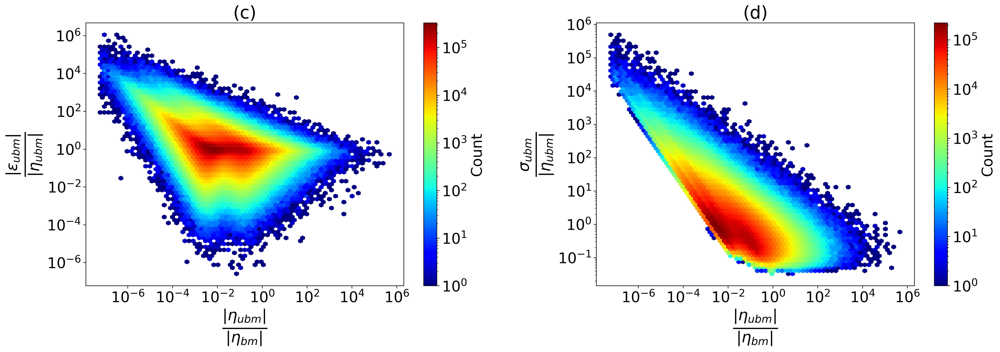

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import xarray as xr
import os

# Create directory if it doesn't exist
save_dir = '/home/jovyan/GRL/figures/'

# Calculate absolute error between true and predicted UBM
ubm_error = np.abs(ubm_true_clean.values - ubm_pre_zca_clean.values)

# Calculate the ratio of UBM to BM magnitudes
epsilon = 1e-10
abs_ubm_true = np.abs(ubm_true_clean.values)
rel_ubm_error = ubm_error / (abs_ubm_true + epsilon)
rel_ubm_uncertainty = ubm_uncertainty_clean.values / (abs_ubm_true + epsilon)  # Normalize by true mean
ubm_bm_ratio = abs_ubm_true / (np.abs(bm_true_clean.values) + epsilon)

# Create a figure with 1x2 subplots
fig, axes = plt.subplots(1, 2, figsize=(20, 8), dpi=300)

# Increase font size globally
plt.rcParams.update({'font.size': 20})  # Base font size

# Function to create a subplot with hexbin
def create_subplot(ax, x_data, y_data, x_label, y_label, title):
    # Flatten arrays
    x_flat = x_data.flatten()
    y_flat = y_data.flatten()
    
    # Remove any NaN or Inf values
    valid_idx = np.isfinite(x_flat) & np.isfinite(y_flat) & (x_flat > 0) & (y_flat > 0)
    x_flat = x_flat[valid_idx]
    y_flat = y_flat[valid_idx]
    
    # Create hexbin plot with log scales
    hb = ax.hexbin(x_flat, y_flat, gridsize=70, bins='log', cmap='jet', 
                   xscale='log', yscale='log', mincnt=1)
    
    # Set labels and title with increased font size
    ax.set_xlabel(x_label, fontsize=30)
    ax.set_ylabel(y_label, fontsize=30)
    ax.set_title(title, fontsize=24)  # Increased font size for titles
    
    # Increase tick label sizes
    ax.tick_params(axis='both', which='major', labelsize=20)
    ax.tick_params(axis='both', which='minor', labelsize=20)
    
    # Add colorbar
    cbar = plt.colorbar(hb, ax=ax)
    cbar.set_label('Count', fontsize=20)
    cbar.ax.tick_params(labelsize=20)
    
    return hb

# Left subplot: Relative UBM Error vs UBM/BM Magnitude Ratio
hb1 = create_subplot(
    axes[0],
    ubm_bm_ratio,
    rel_ubm_error,
    r"$\frac{|\eta_{ubm}|}{|\eta_{bm}|}$",
    r"$\frac{|\epsilon_{ubm}|}{|\eta_{ubm}|}$",
    "(c)"  # Title for left subplot
)

# Right subplot: Relative UBM Uncertainty vs UBM/BM Magnitude Ratio
hb2 = create_subplot(
    axes[1],
    ubm_bm_ratio,
    rel_ubm_uncertainty,
    r"$\frac{|\eta_{ubm}|}{|\eta_{bm}|}$",
    r"$\frac{\sigma_{ubm}}{|\eta_{ubm}|}$", 
    "(d)"  # Title for right subplot
)

# Tighter layout with more space for text
plt.tight_layout(rect=[0, 0, 1, 0.95], pad=2.0)

# Save figure with high resolution
save_path = os.path.join(save_dir, 'ubm_error_uncertainty_analysis.pdf')
plt.savefig(save_path, dpi=300, bbox_inches='tight')
print(f"Figure saved to {save_path}")

# Also display the figure
plt.show()

Figure saved to /home/jovyan/GRL/figures/ubm_error_uncertainty_analysis.pdf


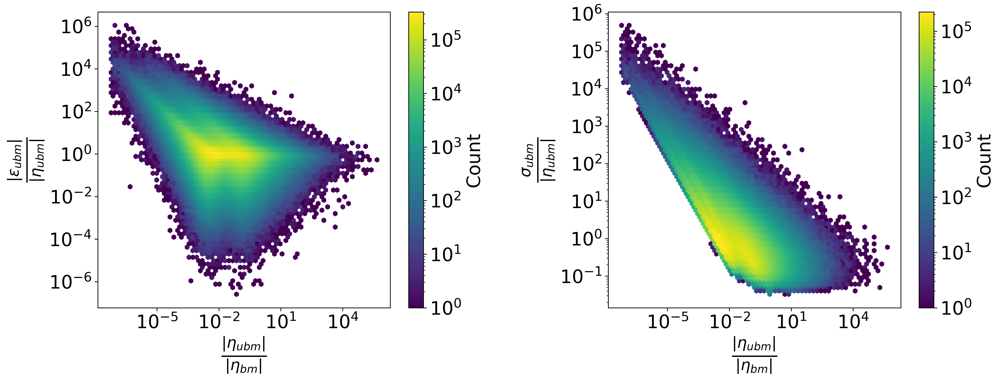

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import xarray as xr
import os

# Create directory if it doesn't exist
save_dir = '/home/jovyan/GRL/figures/'

# Calculate absolute error between true and predicted UBM
ubm_error = np.abs(ubm_true_clean.values - ubm_pre_zca_clean.values)

# Calculate the ratio of UBM to BM magnitudes
epsilon = 1e-10
abs_ubm_true = np.abs(ubm_true_clean.values)
rel_ubm_error = ubm_error / (abs_ubm_true + epsilon)
rel_ubm_uncertainty = ubm_uncertainty_clean.values / (abs_ubm_true + epsilon)  # Normalize by true mean
ubm_bm_ratio = abs_ubm_true / (np.abs(bm_true_clean.values) + epsilon)

# Create a figure with 1x2 subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 7), dpi=300)

# Increase font size globally
plt.rcParams.update({'font.size': 20})  # Base font size

# Function to create a subplot with hexbin
def create_subplot(ax, x_data, y_data, x_label, y_label, title):
    # Flatten arrays
    x_flat = x_data.flatten()
    y_flat = y_data.flatten()
    
    # Remove any NaN or Inf values
    valid_idx = np.isfinite(x_flat) & np.isfinite(y_flat) & (x_flat > 0) & (y_flat > 0)
    x_flat = x_flat[valid_idx]
    y_flat = y_flat[valid_idx]
    
    # Create hexbin plot with log scales
    hb = ax.hexbin(x_flat, y_flat, gridsize=70, bins='log', cmap='viridis', 
                   xscale='log', yscale='log', mincnt=1)
    
    # Set labels and title with increased font size
    ax.set_xlabel(x_label, fontsize=24)
    ax.set_ylabel(y_label, fontsize=24)
    ax.set_title(title, fontsize=24)
    
    # Increase tick label sizes
    ax.tick_params(axis='both', which='major', labelsize=20)
    ax.tick_params(axis='both', which='minor', labelsize=20)
    
    # Add colorbar
    cbar = plt.colorbar(hb, ax=ax)
    cbar.set_label('Count', fontsize=20)
    cbar.ax.tick_params(labelsize=20)
    
    return hb

# Left subplot: Relative UBM Error vs UBM/BM Magnitude Ratio
hb1 = create_subplot(
    axes[0],
    ubm_bm_ratio,
    rel_ubm_error,
    r"$\frac{|\eta_{ubm}|}{|\eta_{bm}|}$",
    r"$\frac{|\epsilon_{ubm}|}{|\eta_{ubm}|}$",
    ""
)

# Right subplot: Relative UBM Uncertainty vs UBM/BM Magnitude Ratio
hb2 = create_subplot(
    axes[1],
    ubm_bm_ratio,
    rel_ubm_uncertainty,
    r"$\frac{|\eta_{ubm}|}{|\eta_{bm}|}$",
    r"$\frac{\sigma_{ubm}}{|\eta_{ubm}|}$", 
    ""
)

# Tighter layout with more space for text
plt.tight_layout(rect=[0, 0, 1, 0.95], pad=2.0)

# Save figure with high resolution
save_path = os.path.join(save_dir, 'ubm_error_uncertainty_analysis.pdf')
plt.savefig(save_path, dpi=300, bbox_inches='tight')

print(f"Figure saved to {save_path}")

# Also display the figure
plt.show()

## PSD

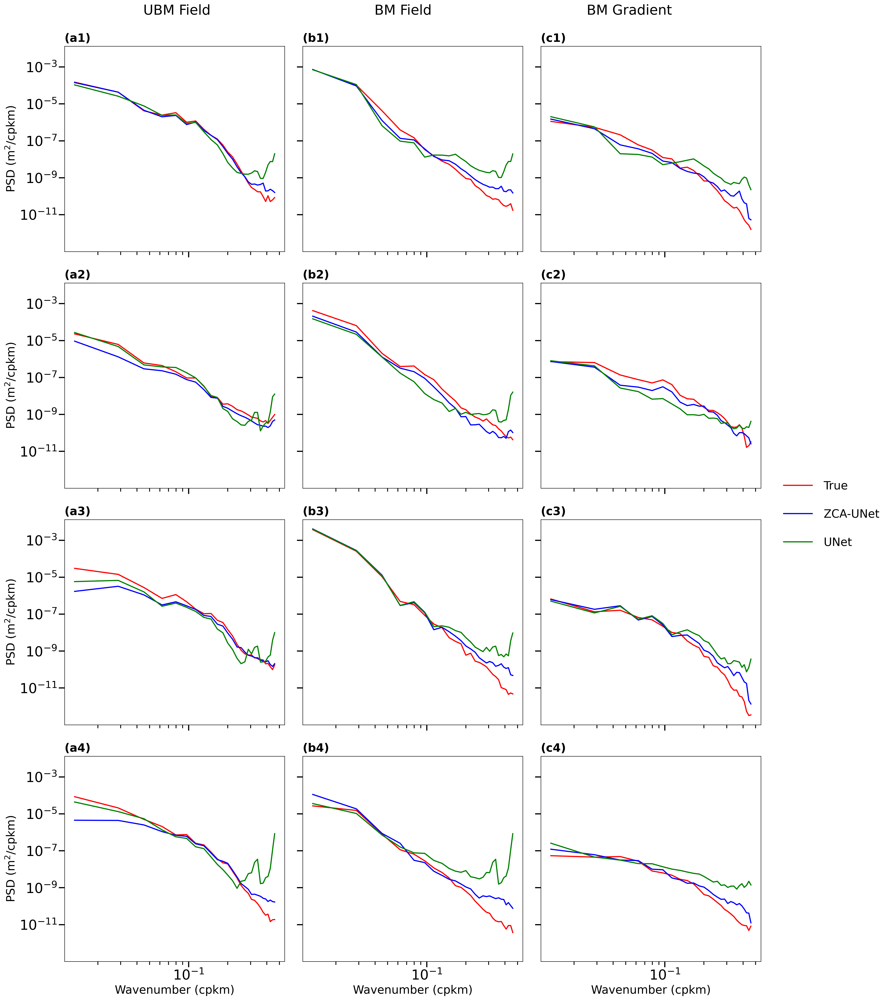

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import warnings
import matplotlib.ticker as ticker
# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning, module='xrft')
# Set default font sizes for the plots
plt.rcParams.update({
    'font.size': 20,
    'axes.labelsize': 24,
    'axes.titlesize': 24,
    'xtick.labelsize': 24,
    'ytick.labelsize': 24,
    'legend.fontsize': 24,
    'xtick.major.size': 10,     # Length of major x-ticks (default is usually 3.5)
    'xtick.minor.size': 6,      # Length of minor x-ticks
    'ytick.major.size': 10,     # Length of major y-ticks
    'ytick.minor.size': 6,      # Length of minor y-ticks
    'xtick.major.width': 2,     # Width of major x-ticks
    'xtick.minor.width': 1.5,   # Width of minor x-ticks
    'ytick.major.width': 2,     # Width of major y-ticks
    'ytick.minor.width': 1.5    # Width of minor y-ticks
})
# Title parameters
title_fontsize = 20
title_weight = 'bold'
title_pad = 8

def calculate_psd(data):
    """
    Calculate the isotropic power spectral density (PSD) for a given 2D array.
    Accounts for 1.5 km grid spacing.
    """
    # Physical grid spacing in km
    dx = dy = 1.5  # km per grid point
    
    data_da = xr.DataArray(
        data,
        dims=['i', 'j'],
        coords={
            'i': dx * np.arange(data.shape[0]),  # Convert to physical distance
            'j': dy * np.arange(data.shape[1])   # Convert to physical distance
        }
    )
    
    psd = isotropic_spectra(data_da)
    
    return psd


# Sample 55
sample_55_ssh = ssh_clean.isel(sample=55).values
sample_55_mu_zca = mu_zca_clean.isel(sample=55).values
sample_55_sigma_zca = sigma_zca_clean.isel(sample=55).values
sample_55_ubm_pre_zca = ubm_pre_zca_clean.isel(sample=55).values
sample_55_ubm_pre_unet = ubm_pre_unet_clean.isel(sample=55).values
sample_55_ubm_true = ubm_true_clean.isel(sample=55).values
sample_55_ubm_uncertainty = ubm_uncertainty_clean.isel(sample=55).values
sample_55_bm_pre_zca = bm_pre_zca_clean.isel(sample=55).values
sample_55_bm_pre_unet = bm_pre_unet_clean.isel(sample=55).values
sample_55_bm_true = bm_true_clean.isel(sample=55).values
sample_55_ssh_grad = calculate_gradient_magnitude(sample_55_ssh)
sample_55_ubm_pre_zca_grad = calculate_gradient_magnitude(sample_55_ubm_pre_zca)
sample_55_ubm_pre_unet_grad = calculate_gradient_magnitude(sample_55_ubm_pre_unet)
sample_55_ubm_true_grad = calculate_gradient_magnitude(sample_55_ubm_true)
sample_55_bm_pre_zca_grad = calculate_gradient_magnitude(sample_55_bm_pre_zca)
sample_55_bm_pre_unet_grad = calculate_gradient_magnitude(sample_55_bm_pre_unet)
sample_55_bm_true_grad = calculate_gradient_magnitude(sample_55_bm_true)

# Sample 88
sample_88_ssh = ssh_clean.isel(sample=88).values
sample_88_mu_zca = mu_zca_clean.isel(sample=88).values
sample_88_sigma_zca = sigma_zca_clean.isel(sample=88).values
sample_88_ubm_pre_zca = ubm_pre_zca_clean.isel(sample=88).values
sample_88_ubm_pre_unet = ubm_pre_unet_clean.isel(sample=88).values
sample_88_ubm_true = ubm_true_clean.isel(sample=88).values
sample_88_ubm_uncertainty = ubm_uncertainty_clean.isel(sample=88).values
sample_88_bm_pre_zca = bm_pre_zca_clean.isel(sample=88).values
sample_88_bm_pre_unet = bm_pre_unet_clean.isel(sample=88).values
sample_88_bm_true = bm_true_clean.isel(sample=88).values
sample_88_ssh_grad = calculate_gradient_magnitude(sample_88_ssh)
sample_88_ubm_pre_zca_grad = calculate_gradient_magnitude(sample_88_ubm_pre_zca)
sample_88_ubm_pre_unet_grad = calculate_gradient_magnitude(sample_88_ubm_pre_unet)
sample_88_ubm_true_grad = calculate_gradient_magnitude(sample_88_ubm_true)
sample_88_bm_pre_zca_grad = calculate_gradient_magnitude(sample_88_bm_pre_zca)
sample_88_bm_pre_unet_grad = calculate_gradient_magnitude(sample_88_bm_pre_unet)
sample_88_bm_true_grad = calculate_gradient_magnitude(sample_88_bm_true)

# Compute PSDs for all samples
# Best sample
best_psd_bm_pre_zca = calculate_psd(best_bm_pre_zca_sample)
best_psd_bm_pre_unet = calculate_psd(best_bm_pre_unet_sample)
best_psd_ubm_pre_zca = calculate_psd(best_ubm_pre_zca_sample)
best_psd_ubm_pre_unet = calculate_psd(best_ubm_pre_unet_sample)
best_psd_bm_true = calculate_psd(best_bm_true_sample)
best_psd_ubm_true = calculate_psd(best_ubm_true_sample)
best_psd_bm_pre_zca_grad = calculate_psd(best_bm_pre_zca_grad_sample)
best_psd_bm_pre_unet_grad = calculate_psd(best_bm_pre_unet_grad_sample)
best_psd_bm_true_grad = calculate_psd(best_bm_true_grad_sample)

# Worst sample
worst_psd_bm_pre_zca = calculate_psd(worst_bm_pre_zca_sample)
worst_psd_bm_pre_unet = calculate_psd(worst_bm_pre_unet_sample)
worst_psd_ubm_pre_zca = calculate_psd(worst_ubm_pre_zca_sample)
worst_psd_ubm_pre_unet = calculate_psd(worst_ubm_pre_unet_sample)
worst_psd_bm_true = calculate_psd(worst_bm_true_sample)
worst_psd_ubm_true = calculate_psd(worst_ubm_true_sample)
worst_psd_bm_pre_zca_grad = calculate_psd(worst_bm_pre_zca_grad_sample)
worst_psd_bm_pre_unet_grad = calculate_psd(worst_bm_pre_unet_grad_sample)
worst_psd_bm_true_grad = calculate_psd(worst_bm_true_grad_sample)

# Sample 55
sample_55_psd_bm_pre_zca = calculate_psd(sample_55_bm_pre_zca)
sample_55_psd_bm_pre_unet = calculate_psd(sample_55_bm_pre_unet)
sample_55_psd_ubm_pre_zca = calculate_psd(sample_55_ubm_pre_zca)
sample_55_psd_ubm_pre_unet = calculate_psd(sample_55_ubm_pre_unet)
sample_55_psd_bm_true = calculate_psd(sample_55_bm_true)
sample_55_psd_ubm_true = calculate_psd(sample_55_ubm_true)
sample_55_psd_bm_pre_zca_grad = calculate_psd(sample_55_bm_pre_zca_grad)
sample_55_psd_bm_pre_unet_grad = calculate_psd(sample_55_bm_pre_unet_grad)
sample_55_psd_bm_true_grad = calculate_psd(sample_55_bm_true_grad)

# Sample 88
sample_88_psd_bm_pre_zca = calculate_psd(sample_88_bm_pre_zca)
sample_88_psd_bm_pre_unet = calculate_psd(sample_88_bm_pre_unet)
sample_88_psd_ubm_pre_zca = calculate_psd(sample_88_ubm_pre_zca)
sample_88_psd_ubm_pre_unet = calculate_psd(sample_88_ubm_pre_unet)
sample_88_psd_bm_true = calculate_psd(sample_88_bm_true)
sample_88_psd_ubm_true = calculate_psd(sample_88_ubm_true)
sample_88_psd_bm_pre_zca_grad = calculate_psd(sample_88_bm_pre_zca_grad)
sample_88_psd_bm_pre_unet_grad = calculate_psd(sample_88_bm_pre_unet_grad)
sample_88_psd_bm_true_grad = calculate_psd(sample_88_bm_true_grad)

# Extract wavenumbers (assumed to be the same for all cases)
k_values = best_psd_bm_pre_zca.coords[list(best_psd_bm_pre_zca.coords)[0]].values

# Compute global y-axis limits from all the arrays that will be plotted
all_data = [
    # Best sample
    best_psd_ubm_true.values, best_psd_ubm_pre_zca.values, best_psd_ubm_pre_unet.values,
    best_psd_bm_true.values, best_psd_bm_pre_zca.values, best_psd_bm_pre_unet.values,
    best_psd_bm_true_grad.values, best_psd_bm_pre_zca_grad.values, best_psd_bm_pre_unet_grad.values,
    
    # Worst sample
    worst_psd_ubm_true.values, worst_psd_ubm_pre_zca.values, worst_psd_ubm_pre_unet.values,
    worst_psd_bm_true.values, worst_psd_bm_pre_zca.values, worst_psd_bm_pre_unet.values,
    worst_psd_bm_true_grad.values, worst_psd_bm_pre_zca_grad.values, worst_psd_bm_pre_unet_grad.values,
    
    # Sample 55
    sample_55_psd_ubm_true.values, sample_55_psd_ubm_pre_zca.values, sample_55_psd_ubm_pre_unet.values,
    sample_55_psd_bm_true.values, sample_55_psd_bm_pre_zca.values, sample_55_psd_bm_pre_unet.values,
    sample_55_psd_bm_true_grad.values, sample_55_psd_bm_pre_zca_grad.values, sample_55_psd_bm_pre_unet_grad.values,
    
    # Sample 88
    sample_88_psd_ubm_true.values, sample_88_psd_ubm_pre_zca.values, sample_88_psd_ubm_pre_unet.values,
    sample_88_psd_bm_true.values, sample_88_psd_bm_pre_zca.values, sample_88_psd_bm_pre_unet.values,
    sample_88_psd_bm_true_grad.values, sample_88_psd_bm_pre_zca_grad.values, sample_88_psd_bm_pre_unet_grad.values
]
ymin = min(np.min(data[data > 0]) for data in all_data)  # Exclude zeros for log scale
ymax = max(np.max(data) for data in all_data)

# Create a 4x3 subplot for the comparisons with shared y-axis across all subplots
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(20, 24), sharex='col', sharey=True)

# Define line styles and colors
colors = {'true': 'red', 'zca': 'blue', 'unet': 'green'}
linewidths = {'true': 2, 'zca': 2, 'unet': 2}
labels = {'true': 'True', 'zca': 'ZCA-UNet', 'unet': 'UNet'}

# Plot best sample (first row)
# First subplot: UBM True vs. UBM Predictions (best)
ax = axes[0, 0]
ax.set_title("(a1)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
line1 = ax.plot(k_values, best_psd_ubm_true.values, color=colors['true'], linewidth=linewidths['true'], label=labels['true'])
line2 = ax.plot(k_values, best_psd_ubm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'], label=labels['zca'])
line3 = ax.plot(k_values, best_psd_ubm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'], label=labels['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylabel('PSD (m$^2$/cpkm)', fontsize=20)

# Second subplot: BM True vs. BM Predictions (best)
ax = axes[0, 1]
ax.set_title("(b1)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, best_psd_bm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, best_psd_bm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, best_psd_bm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Third subplot: BM Grad True vs. BM Grad Predictions (best)
ax = axes[0, 2]
ax.set_title("(c1)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, best_psd_bm_true_grad.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, best_psd_bm_pre_zca_grad.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, best_psd_bm_pre_unet_grad.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Plot worst sample (second row)
# First subplot: UBM True vs. UBM Predictions (worst)
ax = axes[1, 0]
ax.set_title("(a2)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, worst_psd_ubm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, worst_psd_ubm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, worst_psd_ubm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylabel('PSD (m$^2$/cpkm)', fontsize=20)

# Second subplot: BM True vs. BM Predictions (worst)
ax = axes[1, 1]
ax.set_title("(b2)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, worst_psd_bm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, worst_psd_bm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, worst_psd_bm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Third subplot: BM Grad True vs. BM Grad Predictions (worst)
ax = axes[1, 2]
ax.set_title("(c2)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, worst_psd_bm_true_grad.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, worst_psd_bm_pre_zca_grad.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, worst_psd_bm_pre_unet_grad.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Plot Sample 55 (third row)
# First subplot: UBM True vs. UBM Predictions (Sample 55)
ax = axes[2, 0]
ax.set_title("(a3)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_55_psd_ubm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_55_psd_ubm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_55_psd_ubm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylabel('PSD (m$^2$/cpkm)', fontsize=20)

# Second subplot: BM True vs. BM Predictions (Sample 55)
ax = axes[2, 1]
ax.set_title("(b3)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_55_psd_bm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_55_psd_bm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_55_psd_bm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Third subplot: BM Grad True vs. BM Grad Predictions (Sample 55)
ax = axes[2, 2]
ax.set_title("(c3)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_55_psd_bm_true_grad.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_55_psd_bm_pre_zca_grad.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_55_psd_bm_pre_unet_grad.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')

# Plot Sample 88 (fourth row)
# First subplot: UBM True vs. UBM Predictions (Sample 88)
ax = axes[3, 0]
ax.set_title("(a4)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_88_psd_ubm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_88_psd_ubm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_88_psd_ubm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Wavenumber (cpkm)', fontsize=20)
ax.set_ylabel('PSD (m$^2$/cpkm)', fontsize=20)

# Second subplot: BM True vs. BM Predictions (Sample 88)
ax = axes[3, 1]
ax.set_title("(b4)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_88_psd_bm_true.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_88_psd_bm_pre_zca.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_88_psd_bm_pre_unet.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Wavenumber (cpkm)', fontsize=20)

# Third subplot: BM Grad True vs. BM Grad Predictions (Sample 88)
ax = axes[3, 2]
ax.set_title("(c4)", fontsize=title_fontsize, fontweight=title_weight, pad=title_pad, loc='left')
ax.plot(k_values, sample_88_psd_bm_true_grad.values, color=colors['true'], linewidth=linewidths['true'])
ax.plot(k_values, sample_88_psd_bm_pre_zca_grad.values, color=colors['zca'], linewidth=linewidths['zca'])
ax.plot(k_values, sample_88_psd_bm_pre_unet_grad.values, color=colors['unet'], linewidth=linewidths['unet'])
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Wavenumber (cpkm)', fontsize=20)

# Create a single legend outside the plots
handles, labels = axes[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', bbox_to_anchor=(1.1, 0.5), 
           fontsize=20, frameon=False, 
           labelspacing=1.5,  # Increase space between legend entries
           handlelength=2.5,  # Make the colored lines longer
           borderpad=1.0,     # Add more padding inside the legend box
           handletextpad=1.0) # Increase space between colored lines and their labels

# Adjust layout to make room for the legend
plt.tight_layout(rect=[0, 0, 0.95, 1])

# Add column labels at the top
fig.text(0.225, 1.01, "UBM Field", ha='center', va='center', fontsize=24)
fig.text(0.5, 1.01, "BM Field", ha='center', va='center', fontsize=24)
fig.text(0.775, 1.01, "BM Gradient", ha='center', va='center', fontsize=24)

# Save and show the figure
plt.savefig('/home/jovyan/GRL/figures/combined_psd_4x3.pdf', bbox_inches='tight', dpi=300)
plt.show()

## Samples White Noise

/tmp/ipykernel_391/2922601199.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.9])  # Adjust layout to make room for colorbar
/tmp/ipykernel_391/2922601199.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.9])  # Adjust layout to make room for colorbar
/tmp/ipykernel_391/2922601199.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.9])  # Adjust layout to make room for colorbar
/tmp/ipykernel_391/2922601199.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.9])  # Adjust layout to make room for colorbar


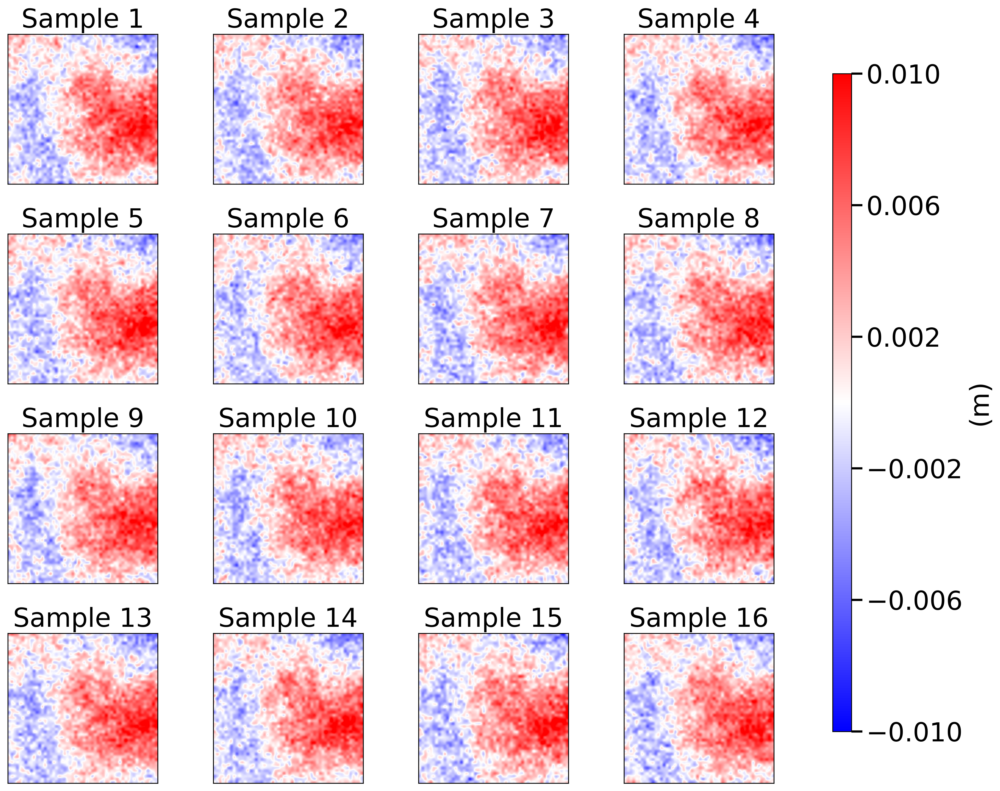

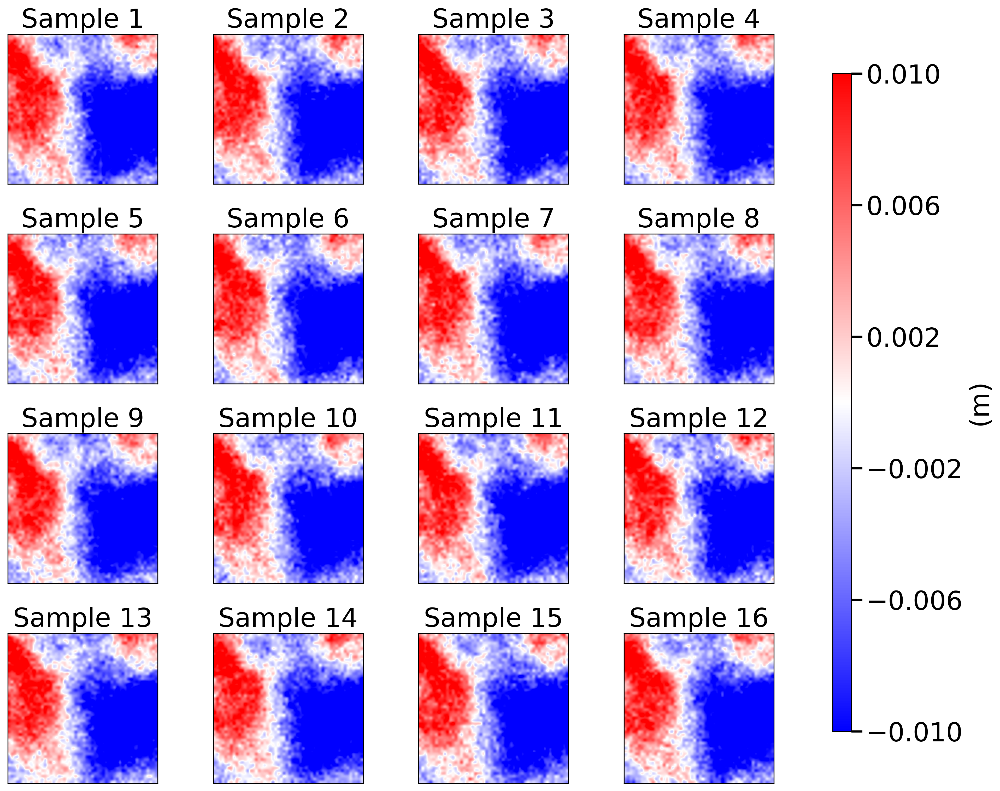

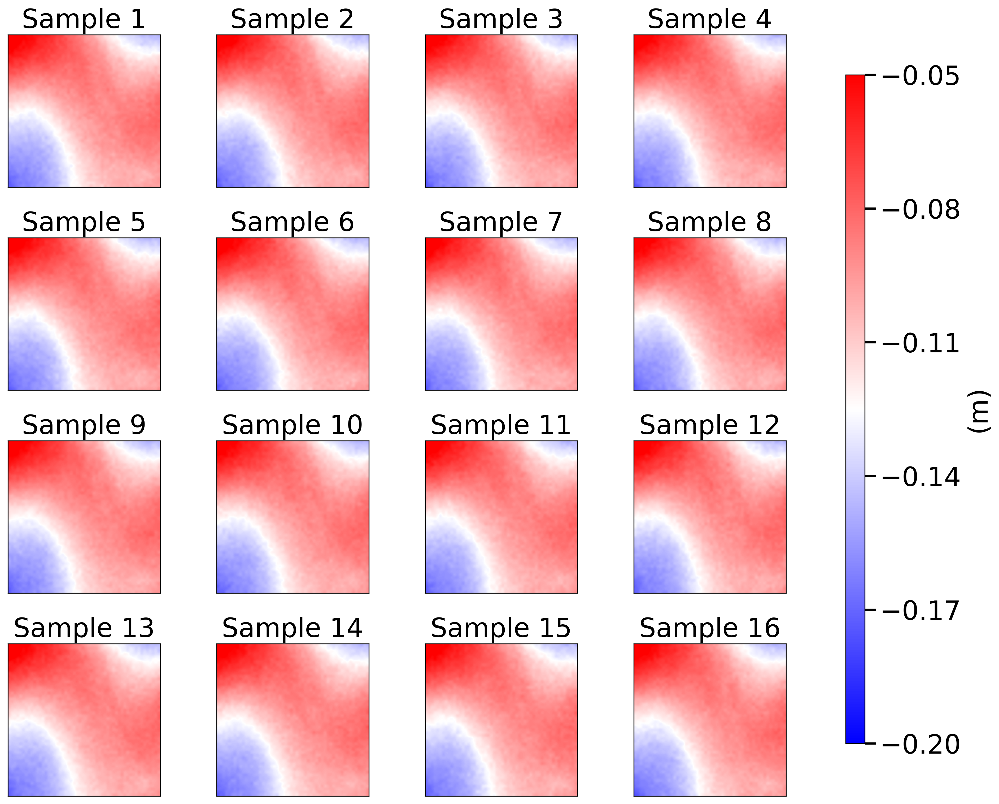

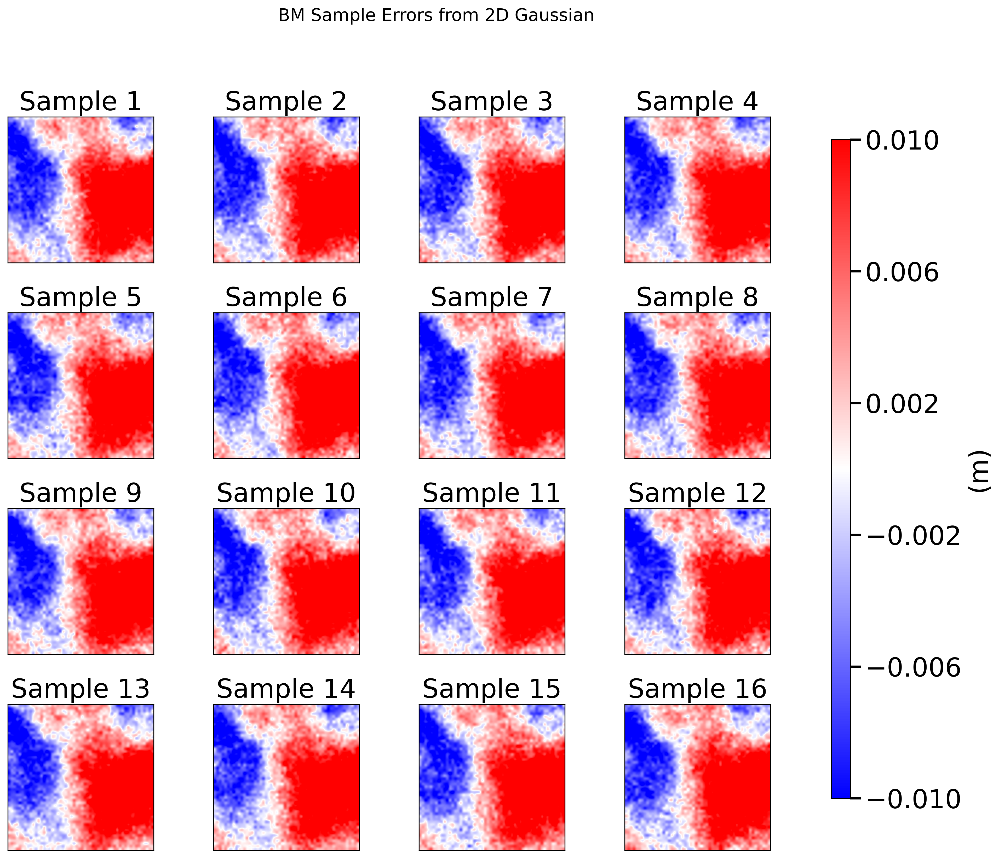

In [17]:
def sample_white(mu, sigma, num_samples=15, seed=42): 
    np.random.seed(seed)
    samples = mu + sigma * np.random.randn(num_samples, *mu.shape)
    return samples

# Generate samples
worst_ubm_sample_white = sample_white(worst_ubm_pre_zca_sample, worst_ubm_uncertainty_sample, num_samples=300, seed=42)
worst_ubm_sample_deviation_white = worst_ubm_true_sample - worst_ubm_sample_white
worst_bm_sample_white = worst_ssh_sample - worst_ubm_sample_white
worst_bm_sample_deviation_white = worst_bm_true_sample - worst_bm_sample_white  # Added BM error calculation

# Setting up common parameters
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

# Function to create a 4x4 grid plot with continuous bwr colormap
def create_grid_plot(samples, title, vmin, vmax, save_path=None):
    """
    Create a 4x4 grid plot from 16 2D samples using continuous bwr colormap
    
    Parameters:
    -----------
    samples : numpy array of shape (16, height, width)
        Array containing 16 2D images
    title : str
        Main title for the figure
    vmin, vmax : float
        Min and max values for color normalization
    save_path : str, optional
        Path to save the figure
    """
    fig, axes = plt.subplots(4, 4, figsize=(12, 12))
    fig.suptitle(title, fontsize=16, y=0.92)
    
    # Flatten the axes for easier iteration
    axes = axes.flatten()
    
    # Loop through each sample and plot
    for i in range(16):
        im = axes[i].imshow(samples[i], 
                          cmap='bwr',  # Using continuous bwr colormap
                          vmin=vmin, 
                          vmax=vmax, 
                          interpolation='gaussian')
        axes[i].set_title(f'Sample {i+1}')
        axes[i].set_xticks([])
        axes[i].set_yticks([])
    
    # Add a colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.08, 0.02, 0.7])  # [x, y, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax)
    cbar.set_label('(m)')
    
    # Add more ticks to colorbar for continuous appearance
    cbar.set_ticks(np.linspace(vmin, vmax, 6))  # 6 ticks for smoother appearance
    # cbar.formatter.set_powerlimits((-2, 2))  # Better scientific notation
    
    plt.tight_layout(rect=[0, 0, 0.9, 0.9])  # Adjust layout to make room for colorbar
    
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    
    return fig

# Plot 1: UBM White Noise Samples
fig1 = create_grid_plot(
    worst_ubm_sample_white[0:16],
    '',
    -0.01, 0.01,
    save_path='/home/jovyan/GRL/figures/ubm_white_samples.pdf'
)

# Plot 2: UBM Deviation Samples (Error)
fig2 = create_grid_plot(
    worst_ubm_sample_deviation_white[0:16],
    '',
    -0.01, 0.01,
    save_path='/home/jovyan/GRL/figures/ubm_deviation_white_samples.pdf'
)

# Plot 3: BM White Noise Samples
fig3 = create_grid_plot(
    worst_bm_sample_white[0:16],
    '',
    -0.2, -0.05,
    save_path='/home/jovyan/GRL/figures/bm_white_samples.pdf'
)

# Plot 4: BM Deviation Samples (Error) - New addition
fig4 = create_grid_plot(
    worst_bm_sample_deviation_white[0:16],
    'BM Sample Errors from 2D Gaussian',
    -0.01, 0.01,
    save_path='/home/jovyan/GRL/figures/bm_deviation_white_samples.pdf'
)

plt.show()

## PSD White Noise

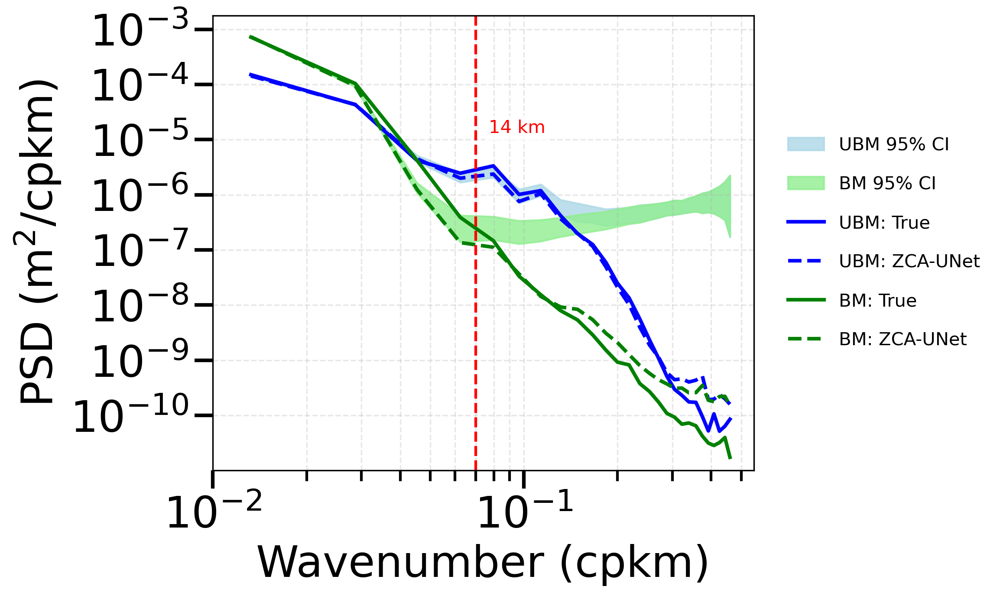

In [18]:
warnings.filterwarnings("ignore", category=FutureWarning, module='xrft')
import matplotlib.gridspec as gridspec


best_ubm_sample_white = sample_white(best_ubm_pre_zca_sample, best_ubm_uncertainty_sample, num_samples=300, seed=42)
best_ubm_sample_deviation_white = best_ubm_true_sample - best_ubm_sample_white
best_bm_sample_white = best_ssh_sample - best_ubm_sample_white
best_bm_sample_deviation_white = best_bm_true_sample - best_bm_sample_white  



def calculate_psd_km(field, dx=1.5):
    """
    field : 2-D numpy array [i, j]   (e.g., ubm sample)
    dx    : km per grid cell
    returns: PSD with coords in cycles km⁻¹ and values in m²/(cycles km⁻¹)
    """
    i_km = np.arange(field.shape[0]) * dx
    j_km = np.arange(field.shape[1]) * dx
    da = xr.DataArray(
        field,
        dims=['i', 'j'],
        coords={'i': i_km, 'j': j_km},
        name='field'
    )
    return isotropic_spectra(da)

def calculate_uncertainty_envelope(samples, dx=1.5):
    """Calculate uncertainty envelope from samples."""
    all_psds = []
    for sample in samples:
        psd = calculate_psd_km(sample, dx=dx)
        all_psds.append(psd.values)
    all_psds_array = np.array(all_psds)
    lower_bound = np.percentile(all_psds_array, 2.5, axis=0)
    upper_bound = np.percentile(all_psds_array, 97.5, axis=0)
    return lower_bound, upper_bound

# Create a single figure with adjusted size to accommodate the legend
fig, ax = plt.subplots(figsize=(8, 5))

# Calculate PSDs
psd_ref = calculate_psd_km(best_ubm_true_sample)
k_values = psd_ref[list(psd_ref.coords.keys())[0]].values

# Calculate and plot uncertainty bands
# UBM uncertainty
ubm_lower, ubm_upper = calculate_uncertainty_envelope(best_ubm_sample_white)
ax.fill_between(k_values, ubm_lower, ubm_upper, color='lightblue', alpha=0.8, label='UBM 95% CI')

# BM uncertainty
bm_lower, bm_upper = calculate_uncertainty_envelope(best_bm_sample_white)
ax.fill_between(k_values, bm_lower, bm_upper, color='lightgreen', alpha=0.8, label='BM 95% CI')

# Plot true values
psd_ubm_true = calculate_psd_km(best_ubm_true_sample)
psd_ubm_pre = calculate_psd_km(best_ubm_pre_zca_sample)
psd_bm_true = calculate_psd_km(best_bm_true_sample)
psd_bm_pre = calculate_psd_km(best_bm_pre_zca_sample)

ax.plot(k_values, psd_ubm_true.values, color='blue', linewidth=2, label='UBM: True')
ax.plot(k_values, psd_ubm_pre.values, color='blue', linewidth=2, label='UBM: ZCA-UNet', linestyle='--')
ax.plot(k_values, psd_bm_true.values, color='green', linewidth=2, label='BM: True')
ax.plot(k_values, psd_bm_pre.values, color='green', linewidth=2, label='BM: ZCA-UNet',linestyle='--')

# Customize plot
ax.set_xscale('log')
ax.set_yscale('log')

# Set the x and y axis limits
ax.set_xlim(1e-2, ax.get_xlim()[1]) 
ax.set_ylim(1e-11, ax.get_ylim()[1])

# Set custom tick locations for y-axis (powers of 10^-1)
import matplotlib.ticker as ticker
y_ticks = [10**i for i in range(-10, 1)]  # From 10^-10 to 10^0
ax.yaxis.set_major_locator(ticker.FixedLocator(y_ticks))
ax.yaxis.set_major_formatter(ticker.LogFormatterMathtext())

# Add vertical line at x = 7×10^-2 
x_mark = 7e-2
ax.axvline(x=x_mark, color='red', linestyle='--', linewidth=1.5)

# Add text label for the vertical line
# Position the text slightly above the middle of the y-axis range in log space
y_position = 10**((np.log10(ax.get_ylim()[0]) + np.log10(ax.get_ylim()[1])) / 2 + 2)  # Slightly above middle in log space
ax.text(x_mark*1.1, y_position, '14 km', color='red', fontsize=10, 
        bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', pad=2))

ax.set_xlabel(r'Wavenumber (cpkm)')
ax.set_ylabel(r'PSD ($\mathrm{m}^2$/cpkm)')
ax.grid(True, which='both', linestyle='--', alpha=0.3)

# Move legend outside to the right middle of the figure
legend = ax.legend(
    loc='center left',
    bbox_to_anchor=(1.05, 0.5),
    frameon=False,
    fontsize=10,
    borderaxespad=0.,
    labelspacing=1.2  # Increase space between legend entries
)

# Adjust layout to make room for the legend
plt.tight_layout()
# Adjust right margin to make room for the legend
plt.subplots_adjust(right=0.75)
plt.savefig('/home/jovyan/GRL/figures/psd_comparison.pdf', bbox_inches='tight', dpi=300)
plt.show()

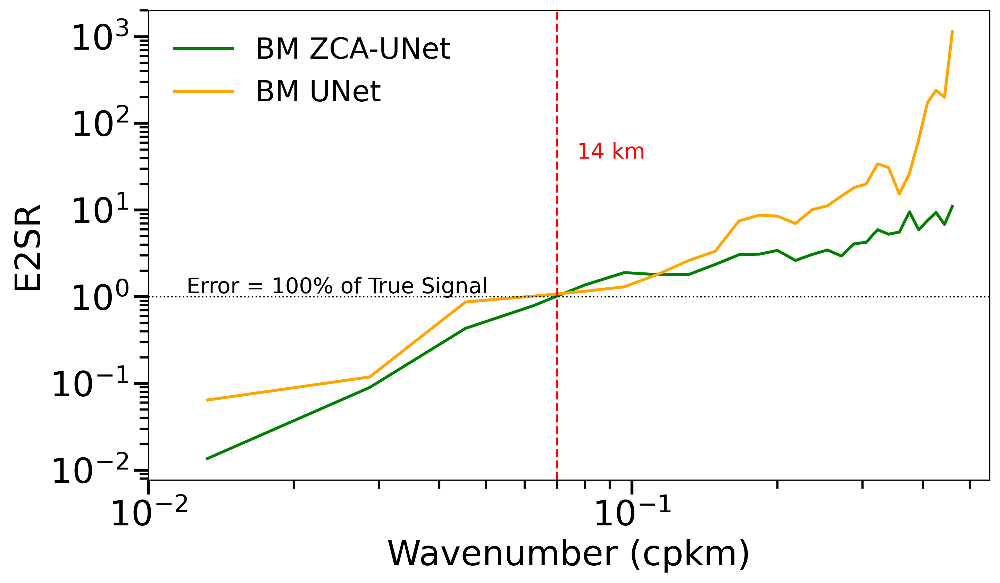

In [19]:
# Create a separate figure for spectral error fractions (E2SR)
fig_ratio, ax_ratio = plt.subplots(figsize=(10, 6))

# Calculate PSDs
psd_ref = calculate_psd_km(best_ubm_true_sample)
k_values = psd_ref[list(psd_ref.coords.keys())[0]].values

# Calculate PSDs for true samples
psd_bm_true = calculate_psd_km(best_bm_true_sample)

# Calculate PSDs for ZCA-UNet predictions
psd_bm_pre_zca = calculate_psd_km(best_bm_pre_zca_sample)

# Calculate PSDs for pure UNet predictions
psd_bm_pre_unet = calculate_psd_km(best_bm_pre_unet_sample)

# Calculate PSD of the differences (ZCA-UNet)
psd_bm_diff_zca = calculate_psd_km(best_bm_true_sample - best_bm_pre_zca_sample)

# Calculate PSD of the differences (pure UNet)
psd_bm_diff_unet = calculate_psd_km(best_bm_true_sample - best_bm_pre_unet_sample)

# Calculate the E2SR: PSD(diff) / PSD(true)
# For ZCA-UNet
psd_bm_e2sr_zca = psd_bm_diff_zca.values / psd_bm_true.values

# For pure UNet
psd_bm_e2sr_unet = psd_bm_diff_unet.values / psd_bm_true.values

# Plot only BM E2SR lines
# ZCA-UNet in red
ax_ratio.plot(k_values, psd_bm_e2sr_zca, color='green', linewidth=2, 
          label='BM ZCA-UNet')

# Pure UNet in blue
ax_ratio.plot(k_values, psd_bm_e2sr_unet, color='orange', linewidth=2,
          label='BM UNet')

# Customize plot
ax_ratio.set_xscale('log')
ax_ratio.set_yscale('log')

# Set the x axis limits
ax_ratio.set_xlim(1e-2, ax_ratio.get_xlim()[1])


x_mark = 7e-2
ax_ratio.axvline(x=x_mark, color='red', linestyle='--', linewidth=1.5)

# Add text label for the vertical line
y_position = 10**((np.log10(ax_ratio.get_ylim()[0]) + np.log10(ax_ratio.get_ylim()[1])) / 2 + 1)
ax_ratio.text(x_mark*1.1, y_position, '14 km', color='red', fontsize=15,
          bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', pad=2))

# Add horizontal line at y = 1.0 to indicate "100% of true signal"
ax_ratio.axhline(y=1.0, color='black', linestyle=':', linewidth=1.0)
ax_ratio.text(ax_ratio.get_xlim()[0]*1.2, 1.1, 'Error = 100% of True Signal', 
          fontsize=15, color='black')

ax_ratio.set_xlabel(r'Wavenumber (cpkm)')
ax_ratio.set_ylabel(r'E2SR')

# Add legend with custom positioning and formatting
legend = ax_ratio.legend(
    loc='best',
    fontsize=20,
    frameon=False
)

plt.tight_layout()
plt.savefig('/home/jovyan/GRL/figures/psd_error_to_signal_ratio.pdf', bbox_inches='tight', dpi=300)
plt.show()

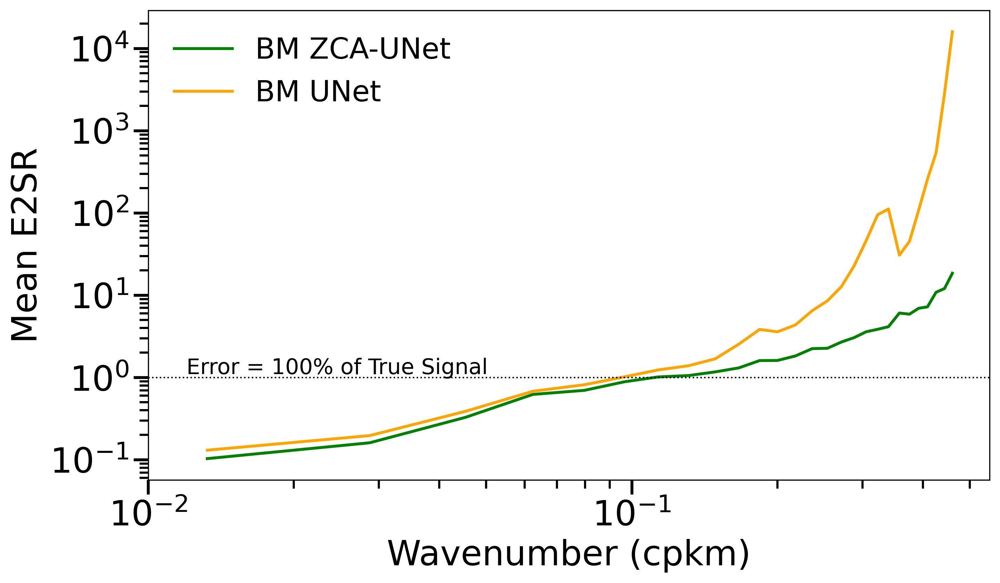

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import xrft
import random

# Set random seed for reproducibility
np.random.seed(42)

# Sample 50 random indices from the dataset
def sample_random_indices(data_shape, n_samples=50):
    total_samples = data_shape[0]
    indices = random.sample(range(total_samples), min(n_samples, total_samples))
    return indices

# Calculate mean E2SR across samples
def calculate_mean_e2sr(true_samples, pred_samples, indices):
    # Initialize lists to store E2SR values for each sample
    all_e2sr = []
    all_k_values = []
    
    for idx in indices:
        # Get individual samples
        true_sample = true_samples[idx]
        pred_sample = pred_samples[idx]
        
        # Calculate PSDs
        psd_true = calculate_psd_km(true_sample)
        psd_diff = calculate_psd_km(true_sample - pred_sample)
        
        # Calculate E2SR: PSD(diff) / PSD(true)
        e2sr = psd_diff.values / psd_true.values
        
        # Store results
        all_e2sr.append(e2sr)
        all_k_values.append(psd_true[list(psd_true.coords.keys())[0]].values)
    
    # Convert to numpy arrays for easier manipulation
    all_e2sr = np.array(all_e2sr)
    
    # Use the first k_values (should be the same for all samples)
    k_values = all_k_values[0]
    
    # Calculate mean E2SR
    mean_e2sr = np.mean(all_e2sr, axis=0)
    
    return mean_e2sr, k_values

# Main code
# Sample 50 random indices
indices = sample_random_indices(bm_true_clean.values.shape, n_samples=50)

# Calculate mean E2SR for ZCA-UNet
mean_e2sr_zca, k_values = calculate_mean_e2sr(
    bm_true_clean.values, 
    bm_pre_zca_clean.values, 
    indices
)

# Calculate mean E2SR for pure UNet
mean_e2sr_unet, _ = calculate_mean_e2sr(
    bm_true_clean.values, 
    bm_pre_unet_clean.values, 
    indices
)

# Create a figure for mean spectral error fractions (E2SR)
fig_ratio, ax_ratio = plt.subplots(figsize=(10, 6))

# Plot mean E2SR lines
# ZCA-UNet in green
ax_ratio.plot(k_values, mean_e2sr_zca, color='green', linewidth=2, 
          label='BM ZCA-UNet')

# Pure UNet in orange
ax_ratio.plot(k_values, mean_e2sr_unet, color='orange', linewidth=2,
          label='BM UNet')

# Customize plot
ax_ratio.set_xscale('log')
ax_ratio.set_yscale('log')

# Set the x axis limits
ax_ratio.set_xlim(1e-2, ax_ratio.get_xlim()[1])


# Add horizontal line at y = 1.0 to indicate "100% of true signal"
ax_ratio.axhline(y=1.0, color='black', linestyle=':', linewidth=1.0)
ax_ratio.text(ax_ratio.get_xlim()[0]*1.2, 1.1, 'Error = 100% of True Signal', 
          fontsize=15, color='black')

# Set labels
ax_ratio.set_xlabel(r'Wavenumber (cpkm)')
ax_ratio.set_ylabel(r'Mean E2SR')


# Add legend with custom positioning and formatting
legend = ax_ratio.legend(
    loc='best',
    fontsize=20,
    frameon=False
)

plt.tight_layout()
plt.savefig('psd_mean_error_to_signal_ratio.pdf', bbox_inches='tight', dpi=300)
plt.show()


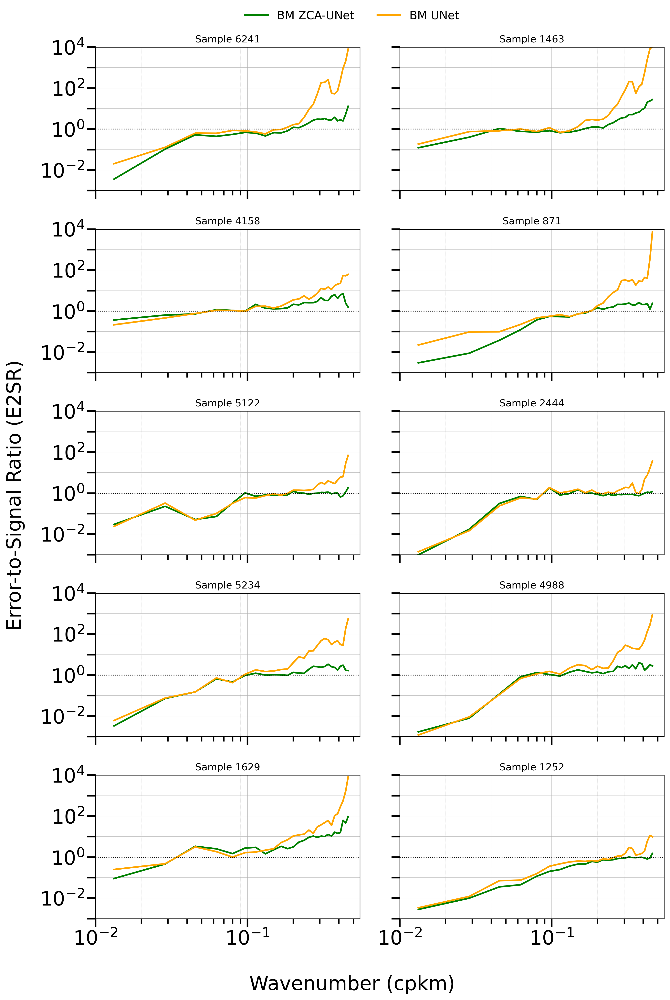

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import xrft
import random

# Set random seed for reproducibility
np.random.seed(42)

# Sample random indices from the dataset
def sample_random_indices(data_shape, n_samples=10):
    total_samples = data_shape[0]
    indices = random.sample(range(total_samples), min(n_samples, total_samples))
    return indices

# Calculate E2SR for a single sample
def calculate_single_e2sr(true_sample, pred_sample):
    # Calculate PSDs
    psd_true = calculate_psd_km(true_sample)
    psd_diff = calculate_psd_km(true_sample - pred_sample)
    
    # Calculate E2SR: PSD(diff) / PSD(true)
    e2sr = psd_diff.values / psd_true.values
    
    # Get k values
    k_values = psd_true[list(psd_true.coords.keys())[0]].values
    
    return e2sr, k_values

# Main code
# Sample 10 random indices
indices = sample_random_indices(bm_true_clean.values.shape, n_samples=10)

# Create a figure for individual E2SR subplots
fig, axes = plt.subplots(5, 2, figsize=(14, 20), sharex=True, sharey=True)
axes = axes.flatten()

# Plot individual samples
for i, idx in enumerate(indices):
    # Get individual samples
    true_sample = bm_true_clean.values[idx]
    pred_zca_sample = bm_pre_zca_clean.values[idx]
    pred_unet_sample = bm_pre_unet_clean.values[idx]
    
    # Calculate E2SR for ZCA-UNet
    e2sr_zca, k_values = calculate_single_e2sr(true_sample, pred_zca_sample)
    
    # Calculate E2SR for pure UNet
    e2sr_unet, _ = calculate_single_e2sr(true_sample, pred_unet_sample)
    
    # Plot E2SR lines on the corresponding subplot
    ax = axes[i]
    
    # ZCA-UNet in green
    ax.plot(k_values, e2sr_zca, color='green', linewidth=2, 
            label='BM ZCA-UNet' if i == 0 else None)
    
    # Pure UNet in orange
    ax.plot(k_values, e2sr_unet, color='orange', linewidth=2,
            label='BM UNet' if i == 0 else None)
    
    # Customize subplot
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlim(1e-2, ax.get_xlim()[1])
    
    # Set y-axis limits and detailed tick marks
    ax.set_ylim(1e-3, 1e4)
    
    # Set y-axis tick marks but only label every 10^2
    y_ticks_major = [10**n for n in range(-3, 5)]  # All ticks still appear
    ax.set_yticks(y_ticks_major)
    
    # Only label every other tick (every 10^2)
    y_labels = []
    for n in range(-3, 5):
        if n % 2 == 1:  # For odd powers, show empty label
            y_labels.append('')
        else:  # For even powers (-2, 0, 2, 4), show label
            y_labels.append(f'$10^{{{n}}}$')
    
    ax.set_yticklabels(y_labels)
        
    # Add horizontal line at y = 1.0
    ax.axhline(y=1.0, color='black', linestyle=':', linewidth=1.0)
    
    # Add sample number as title
    ax.set_title(f'Sample {idx}', fontsize=12)
    
    # Add grid for better readability
    ax.grid(True, which='major', linestyle='-', linewidth=0.5, alpha=0.7)
    ax.grid(True, which='minor', linestyle='--', linewidth=0.2, alpha=0.4)

# Set common labels
fig.text(0.5, 0.08, r'Wavenumber (cpkm)', ha='center', fontsize=24)
fig.text(0.08, 0.5, r'Error-to-Signal Ratio (E2SR)', va='center', rotation='vertical', fontsize=24)

# Add a single legend for the entire figure
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.92), 
           ncol=2, fontsize=14, frameon=False)


plt.tight_layout(rect=[0.1, 0.1, 0.9, 0.9])
plt.subplots_adjust(top=0.88)
plt.savefig('psd_individual_error_to_signal_ratio.pdf', bbox_inches='tight', dpi=300)
plt.show()

## GF

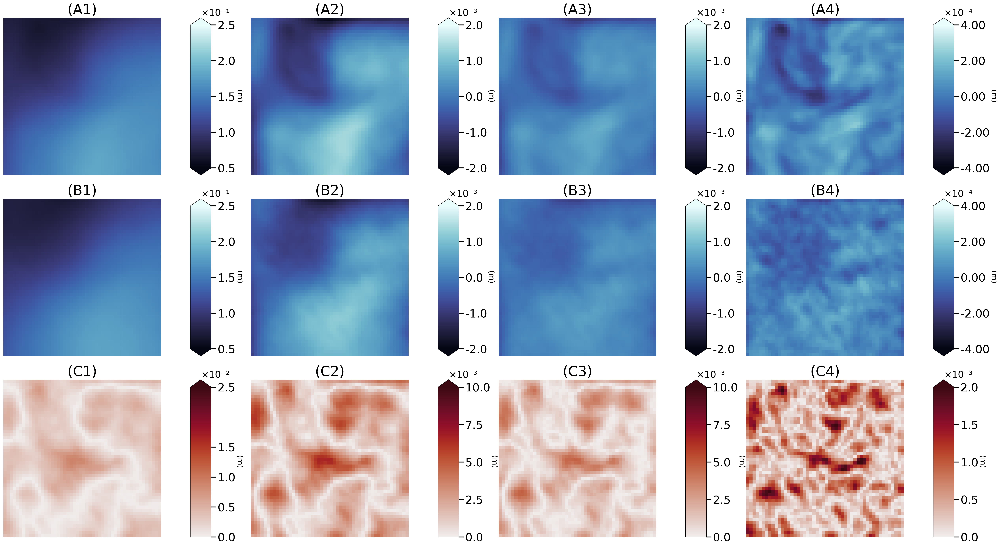

In [21]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import xarray as xr
import cmocean  # Added import for cmocean
from matplotlib import gridspec
from matplotlib.colors import Normalize
from scipy.ndimage import gaussian_filter

# Set DPI parameters 
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

# Set title parameters
title_fontsize = 30 
title_pad = 8

# ----------------------
# Define plotting parameters
# ----------------------
# Column 1: Original data
vmin_orig, vmax_orig = 0.05, 0.25

# Column 2: Features < 50km (changed from 65km)
vmin_50, vmax_50 = -0.02, 0.02  # Adjusted for 50km scale

# Column 3: Features < 30km (changed from 12.5km)
vmin_30, vmax_30 = -0.02, 0.02

# Column 4: Features < 12.5km (changed from 5km)
vmin_12_5, vmax_12_5 = -0.004, 0.004

# NEW: Define parameters for absolute error
# Using appropriate scales for each column
vmin_abs_orig, vmax_abs_orig = 0, 0.025  # Absolute error for original data
vmin_abs_50, vmax_abs_50 = 0, 0.01  # Absolute error for 50km features
vmin_abs_30, vmax_abs_30 = 0, 0.01  # Absolute error for 30km features
vmin_abs_12_5, vmax_abs_12_5 = 0, 0.002  # Absolute error for 12.5km features

# Tick setup for different scales
ticks_orig = np.array([0.5, 1.0, 1.5, 2.0, 2.5])
ticks_50 = np.array([-2.0, -1.0, 0.0, 1.0, 2.0])  # Changed ticks for 50km
ticks_30 = np.array([-2.0, -1.0, 0.0, 1.0, 2.0])  # Changed ticks for 30km
ticks_12_5 = np.array([-4.0, -2.0, 0.0, 2.0, 4.0])  # Changed ticks for 12.5km

# NEW: Define ticks for absolute error
ticks_abs_orig = np.array([0, 0.5, 1.0, 1.5, 2.5])  # Absolute error ticks for original data
ticks_abs_50 = np.array([0, 2.5, 5.0, 7.5, 10.0])  # Absolute error ticks for 50km features
ticks_abs_30 = np.array([0, 2.5, 5.0, 7.5, 10.0])  # Absolute error ticks for 30km features
ticks_abs_12_5 = np.array([0, 0.5, 1.0, 1.5, 2.0])  # Absolute error ticks for 12.5km features

ticks_orig_data = ticks_orig / 10
ticks_50_data = ticks_50 / 100  # Data values for 50km
ticks_30_data = ticks_30 / 100  # Data values for 30km
ticks_12_5_data = ticks_12_5 / 1000  # Data values for 12.5km

# NEW: Define data values for absolute error ticks
ticks_abs_orig_data = ticks_abs_orig / 100  # Absolute error for original data
ticks_abs_50_data = ticks_abs_50 / 1000  # Absolute error for 50km features
ticks_abs_30_data = ticks_abs_30 / 1000  # Absolute error for 30km features
ticks_abs_12_5_data = ticks_abs_12_5 / 1000  # Absolute error for 12.5km features

# Create the size of your arrays
size = best_bm_true_sample.shape[0]
i = np.arange(size)
j = np.arange(size)

# Calculate Gaussian filter parameters based on physical distance
pixel_size = 1.5  # km per grid point

# For features smaller than 50km (changed from 65km)
scale_50km = 50 / pixel_size  # Convert to grid units
sigma_50km = scale_50km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# For features smaller than 30km (changed from 12.5km)
scale_30km = 30 / pixel_size  # Convert to grid units
sigma_30km = scale_30km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# For features smaller than 12.5km (changed from 5km)
scale_12_5km = 12.5 / pixel_size  # Convert to grid units
sigma_12_5km = scale_12_5km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# Apply Gaussian filter to get high-pass filtered versions
# For 50km features (changed from 65km)
true_low_pass_50km = gaussian_filter(best_bm_true_sample, sigma=sigma_50km)
true_high_pass_50km = best_bm_true_sample - true_low_pass_50km
pred_low_pass_50km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_50km)
pred_high_pass_50km = best_bm_pre_zca_sample - pred_low_pass_50km

# For 30km features (changed from 12.5km)
true_low_pass_30km = gaussian_filter(best_bm_true_sample, sigma=sigma_30km)
true_high_pass_30km = best_bm_true_sample - true_low_pass_30km
pred_low_pass_30km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_30km)
pred_high_pass_30km = best_bm_pre_zca_sample - pred_low_pass_30km

# For 12.5km features (changed from 5km)
true_low_pass_12_5km = gaussian_filter(best_bm_true_sample, sigma=sigma_12_5km)
true_high_pass_12_5km = best_bm_true_sample - true_low_pass_12_5km
pred_low_pass_12_5km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_12_5km)
pred_high_pass_12_5km = best_bm_pre_zca_sample - pred_low_pass_12_5km

# Crop the arrays to remove boundary effects
# Define crop width (e.g., 5 pixels from each side)
crop_width = 2

# Crop for 50km features (changed from 65km)
true_high_pass_50km_cropped = true_high_pass_50km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_50km_cropped = pred_high_pass_50km[crop_width:-crop_width, crop_width:-crop_width]

# Crop for 30km features (changed from 12.5km)
true_high_pass_30km_cropped = true_high_pass_30km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_30km_cropped = pred_high_pass_30km[crop_width:-crop_width, crop_width:-crop_width]

# Crop for 12.5km features (changed from 5km)
true_high_pass_12_5km_cropped = true_high_pass_12_5km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_12_5km_cropped = pred_high_pass_12_5km[crop_width:-crop_width, crop_width:-crop_width]

# Also crop the original data for consistency
best_bm_true_sample_cropped = best_bm_true_sample[crop_width:-crop_width, crop_width:-crop_width]
best_bm_pre_zca_sample_cropped = best_bm_pre_zca_sample[crop_width:-crop_width, crop_width:-crop_width]

# NEW: Calculate absolute errors instead of relative errors
# Absolute error for original data
abs_error_orig = np.abs(best_bm_pre_zca_sample_cropped - best_bm_true_sample_cropped)

# Absolute error for 50km features
abs_error_50km = np.abs(pred_high_pass_50km_cropped - true_high_pass_50km_cropped)

# Absolute error for 30km features
abs_error_30km = np.abs(pred_high_pass_30km_cropped - true_high_pass_30km_cropped)

# Absolute error for 12.5km features
abs_error_12_5km = np.abs(pred_high_pass_12_5km_cropped - true_high_pass_12_5km_cropped)

# Create figure with subplots - now with 3 rows, 4 columns of panels
fig = plt.figure(figsize=(38, 20))  # Increased width for 4 columns

# Create a grid with proper alignment - 3 rows, 15 columns
gs = gridspec.GridSpec(3, 15,  
                      width_ratios=[0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08],  
                      height_ratios=[1, 1, 1],
                      wspace=-0.1, hspace=0.15)

# Define colormap as cmocean thermal (changed from plt.cm.RdBu_r)
cmap_bm = cmocean.cm.ice
# NEW: Define colormap for absolute error (using cmocean amp which is a sequential colormap for magnitudes)
cmap_abs_error = cmocean.cm.amp

# Helper function to format the axes with centered titles
def format_ax(ax, title):
    # Remove all ticks
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Set title
    ax.set_title(title, fontsize=title_fontsize, pad=title_pad, loc='center')
    
    # Remove boxes as in reference
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    
# Row 1: True Data
# Column 1: Original data
ax1 = fig.add_subplot(gs[0, 0])
im1 = ax1.imshow(best_bm_true_sample_cropped, cmap=cmap_bm, vmin=vmin_orig, vmax=vmax_orig)
format_ax(ax1, '(A1)')

# Column 2: Features < 50km (changed from 65km)
ax1_5 = fig.add_subplot(gs[0, 4])
im1_5 = ax1_5.imshow(true_high_pass_50km_cropped, cmap=cmap_bm, vmin=vmin_50, vmax=vmax_50)
format_ax(ax1_5, '(A2)')

# Column 3: Features < 30km (changed from 12.5km)
ax2 = fig.add_subplot(gs[0, 8])
im2 = ax2.imshow(true_high_pass_30km_cropped, cmap=cmap_bm, vmin=vmin_30, vmax=vmax_30)
format_ax(ax2, '(A3)')

# Column 4: Features < 12.5km (changed from 5km)
ax3 = fig.add_subplot(gs[0, 12])
im3 = ax3.imshow(true_high_pass_12_5km_cropped, cmap=cmap_bm, vmin=vmin_12_5, vmax=vmax_12_5)
format_ax(ax3, '(A4)')

# Row 2: Predicted Data
# Column 1: Original data
ax4 = fig.add_subplot(gs[1, 0])
im4 = ax4.imshow(best_bm_pre_zca_sample_cropped, cmap=cmap_bm, vmin=vmin_orig, vmax=vmax_orig)
format_ax(ax4, '(B1)')

# Column 2: Features < 50km (changed from 65km)
ax4_5 = fig.add_subplot(gs[1, 4])
im4_5 = ax4_5.imshow(pred_high_pass_50km_cropped, cmap=cmap_bm, vmin=vmin_50, vmax=vmax_50)
format_ax(ax4_5, '(B2)')

# Column 3: Features < 30km (changed from 12.5km)
ax5 = fig.add_subplot(gs[1, 8])
im5 = ax5.imshow(pred_high_pass_30km_cropped, cmap=cmap_bm, vmin=vmin_30, vmax=vmax_30)
format_ax(ax5, '(B3)')

# Column 4: Features < 12.5km (changed from 5km)
ax6 = fig.add_subplot(gs[1, 12])
im6 = ax6.imshow(pred_high_pass_12_5km_cropped, cmap=cmap_bm, vmin=vmin_12_5, vmax=vmax_12_5)
format_ax(ax6, '(B4)')

# Row 3: Absolute Error (CHANGED from Relative Error)
# Column 1: Absolute error for original data
ax7 = fig.add_subplot(gs[2, 0])
im7 = ax7.imshow(abs_error_orig, cmap=cmap_abs_error, vmin=0, vmax=vmax_abs_orig)
format_ax(ax7, '(C1)')

# Column 2: Absolute error for 50km features
ax7_5 = fig.add_subplot(gs[2, 4])
im7_5 = ax7_5.imshow(abs_error_50km, cmap=cmap_abs_error, vmin=0, vmax=vmax_abs_50)
format_ax(ax7_5, '(C2)')

# Column 3: Absolute error for 30km features
ax8 = fig.add_subplot(gs[2, 8])
im8 = ax8.imshow(abs_error_30km, cmap=cmap_abs_error, vmin=0, vmax=vmax_abs_30)
format_ax(ax8, '(C3)')

# Column 4: Absolute error for 12.5km features
ax9 = fig.add_subplot(gs[2, 12])
im9 = ax9.imshow(abs_error_12_5km, cmap=cmap_abs_error, vmin=0, vmax=vmax_abs_12_5)
format_ax(ax9, '(C4)')

# Create colorbars for each panel
# Row 1 colorbars (True data)
# Colorbar for A1
cax1 = fig.add_subplot(gs[0, 2])
cbar1 = plt.colorbar(im1, cax=cax1, extend='both', ticks=ticks_orig_data)
cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')
cbar1.ax.set_yticklabels([f'{x:.1f}' for x in ticks_orig])
cbar1.ax.text(1.2, 1.05, '×10⁻¹', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A2 (50km - changed from 65km)
cax1_5 = fig.add_subplot(gs[0, 6])
cbar1_5 = plt.colorbar(im1_5, cax=cax1_5, extend='both', ticks=ticks_50_data)
cbar1_5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar1_5.ax.yaxis.tick_right()
cbar1_5.ax.yaxis.set_label_position('right')
cbar1_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_50])
cbar1_5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar1_5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A3 (30km - changed from 12.5km)
cax2 = fig.add_subplot(gs[0, 10])
cbar2 = plt.colorbar(im2, cax=cax2, extend='both', ticks=ticks_30_data)
cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')
cbar2.ax.set_yticklabels([f'{x:.1f}' for x in ticks_30])
cbar2.ax.text(1.2, 1.05, '×10⁻³', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A4 (12.5km - changed from 5km)
cax3 = fig.add_subplot(gs[0, 14])
cbar3 = plt.colorbar(im3, cax=cax3, extend='both', ticks=ticks_12_5_data)
cbar3.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar3.ax.yaxis.tick_right()
cbar3.ax.yaxis.set_label_position('right')
cbar3.ax.set_yticklabels([f'{x:.2f}' for x in ticks_12_5])
cbar3.ax.text(1.2, 1.05, '×10⁻⁴', transform=cbar3.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 2 colorbars (Predicted data)
# Colorbar for B1
cax4 = fig.add_subplot(gs[1, 2])
cbar4 = plt.colorbar(im4, cax=cax4, extend='both', ticks=ticks_orig_data)
cbar4.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar4.ax.yaxis.tick_right()
cbar4.ax.yaxis.set_label_position('right')
cbar4.ax.set_yticklabels([f'{x:.1f}' for x in ticks_orig])
cbar4.ax.text(1.2, 1.05, '×10⁻¹', transform=cbar4.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B2 (50km - changed from 65km)
cax4_5 = fig.add_subplot(gs[1, 6])
cbar4_5 = plt.colorbar(im4_5, cax=cax4_5, extend='both', ticks=ticks_50_data)
cbar4_5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar4_5.ax.yaxis.tick_right()
cbar4_5.ax.yaxis.set_label_position('right')
cbar4_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_50])
cbar4_5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar4_5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B3 (30km - changed from 12.5km)
cax5 = fig.add_subplot(gs[1, 10])
cbar5 = plt.colorbar(im5, cax=cax5, extend='both', ticks=ticks_30_data)
cbar5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar5.ax.yaxis.tick_right()
cbar5.ax.yaxis.set_label_position('right')
cbar5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_30])
cbar5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B4 (12.5km - changed from 5km)
cax6 = fig.add_subplot(gs[1, 14])
cbar6 = plt.colorbar(im6, cax=cax6, extend='both', ticks=ticks_12_5_data)
cbar6.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar6.ax.yaxis.tick_right()
cbar6.ax.yaxis.set_label_position('right')
cbar6.ax.set_yticklabels([f'{x:.2f}' for x in ticks_12_5])
cbar6.ax.text(1.2, 1.05, '×10⁻⁴', transform=cbar6.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 3 colorbars (CHANGED to Absolute Error)
# Colorbar for C1
cax7 = fig.add_subplot(gs[2, 2])
cbar7 = plt.colorbar(im7, cax=cax7, extend='max', ticks=ticks_abs_orig_data)
cbar7.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)  # Changed from (%) to (m)
cbar7.ax.yaxis.tick_right()
cbar7.ax.yaxis.set_label_position('right')
cbar7.ax.set_yticklabels([f'{x:.1f}' for x in ticks_abs_orig])
cbar7.ax.text(1.2, 1.05, '×10⁻²', transform=cbar7.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for C2 (50km - changed from 65km)
cax7_5 = fig.add_subplot(gs[2, 6])
cbar7_5 = plt.colorbar(im7_5, cax=cax7_5, extend='max', ticks=ticks_abs_50_data)
cbar7_5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)  # Changed from (%) to (m)
cbar7_5.ax.yaxis.tick_right()
cbar7_5.ax.yaxis.set_label_position('right')
cbar7_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_abs_50])
cbar7_5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar7_5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for C3 (30km - changed from 12.5km)
cax8 = fig.add_subplot(gs[2, 10])
cbar8 = plt.colorbar(im8, cax=cax8, extend='max', ticks=ticks_abs_30_data)
cbar8.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)  # Changed from (%) to (m)
cbar8.ax.yaxis.tick_right()
cbar8.ax.yaxis.set_label_position('right')
cbar8.ax.set_yticklabels([f'{x:.1f}' for x in ticks_abs_30])
cbar8.ax.text(1.2, 1.05, '×10⁻³', transform=cbar8.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for C4 (12.5km - changed from 5km)
cax9 = fig.add_subplot(gs[2, 14])
cbar9 = plt.colorbar(im9, cax=cax9, extend='max', ticks=ticks_abs_12_5_data)
cbar9.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)  # Changed from (%) to (m)
cbar9.ax.yaxis.tick_right()
cbar9.ax.yaxis.set_label_position('right')
cbar9.ax.set_yticklabels([f'{x:.1f}' for x in ticks_abs_12_5])
cbar9.ax.text(1.2, 1.05, '×10⁻³', transform=cbar9.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Save figure
plt.savefig('/home/jovyan/GRL/figures/scales_bm.pdf', bbox_inches='tight', dpi=300, transparent=True)
plt.show()

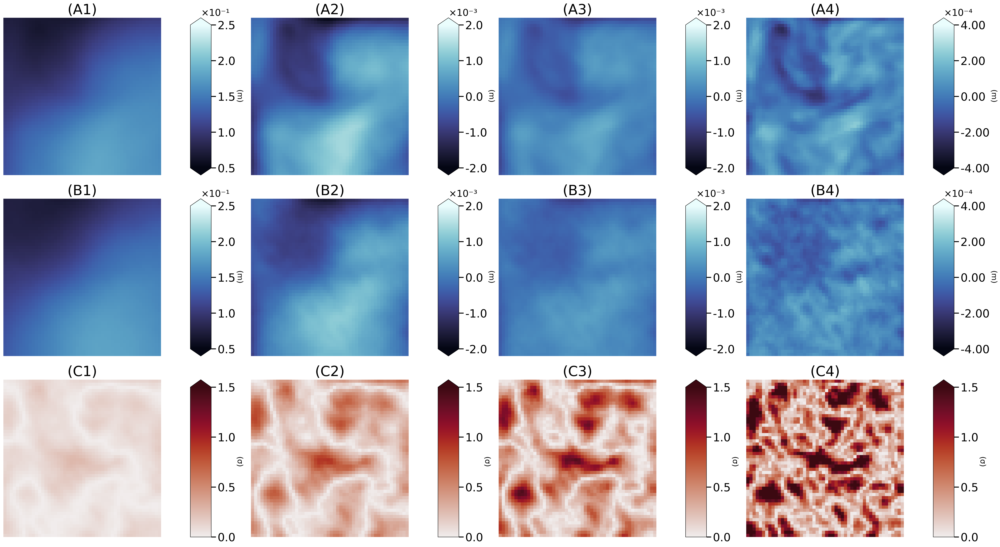

In [22]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import xarray as xr
import cmocean  # Added import for cmocean
from matplotlib import gridspec
from matplotlib.colors import Normalize
from scipy.ndimage import gaussian_filter

# Set DPI parameters 
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

# Set title parameters
title_fontsize = 30 
title_pad = 8

# ----------------------
# Define plotting parameters
# ----------------------
# Column 1: Original data
vmin_orig, vmax_orig = 0.05, 0.25

# Column 2: Features < 50km (changed from 65km)
vmin_50, vmax_50 = -0.02, 0.02  # Adjusted for 50km scale

# Column 3: Features < 30km (changed from 12.5km)
vmin_30, vmax_30 = -0.02, 0.02

# Column 4: Features < 12.5km (changed from 5km)
vmin_12_5, vmax_12_5 = -0.004, 0.004

# NEW: Define parameters for relative error (normalized by std dev)
# Using appropriate scales for each column
vmin_rel_std_orig, vmax_rel_std_orig = 0, 1.5  # Relative error for original data
vmin_rel_std_50, vmax_rel_std_50 = 0, 1.5  # Relative error for 50km features
vmin_rel_std_30, vmax_rel_std_30 = 0, 1.5  # Relative error for 30km features
vmin_rel_std_12_5, vmax_rel_std_12_5 = 0, 1.5  # Relative error for 12.5km features

# Tick setup for different scales
ticks_orig = np.array([0.5, 1.0, 1.5, 2.0, 2.5])
ticks_50 = np.array([-2.0, -1.0, 0.0, 1.0, 2.0])  # Changed ticks for 50km
ticks_30 = np.array([-2.0, -1.0, 0.0, 1.0, 2.0])  # Changed ticks for 30km
ticks_12_5 = np.array([-4.0, -2.0, 0.0, 2.0, 4.0])  # Changed ticks for 12.5km

# NEW: Define ticks for relative error normalized by std dev
ticks_rel_std_orig = np.array([0, 0.5, 1.0, 1.5])  # Relative error ticks for original data
ticks_rel_std_50 = np.array([0, 0.5, 1.0, 1.5])  # Relative error ticks for 50km features
ticks_rel_std_30 = np.array([0, 0.5, 1.0, 1.5])  # Relative error ticks for 30km features
ticks_rel_std_12_5 = np.array([0, 0.5, 1.0, 1.5])  # Relative error ticks for 12.5km features

ticks_orig_data = ticks_orig / 10
ticks_50_data = ticks_50 / 100  # Data values for 50km
ticks_30_data = ticks_30 / 100  # Data values for 30km
ticks_12_5_data = ticks_12_5 / 1000  # Data values for 12.5km

# NEW: Define data values for relative error ticks (normalized by std dev)
ticks_rel_std_orig_data = ticks_rel_std_orig  # No scaling needed
ticks_rel_std_50_data = ticks_rel_std_50  # No scaling needed
ticks_rel_std_30_data = ticks_rel_std_30  # No scaling needed
ticks_rel_std_12_5_data = ticks_rel_std_12_5  # No scaling needed

# Create the size of your arrays
size = best_bm_true_sample.shape[0]
i = np.arange(size)
j = np.arange(size)

# Calculate Gaussian filter parameters based on physical distance
pixel_size = 1.5  # km per grid point

# For features smaller than 50km (changed from 65km)
scale_50km = 50 / pixel_size  # Convert to grid units
sigma_50km = scale_50km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# For features smaller than 30km (changed from 12.5km)
scale_30km = 30 / pixel_size  # Convert to grid units
sigma_30km = scale_30km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# For features smaller than 12.5km (changed from 5km)
scale_12_5km = 12.5 / pixel_size  # Convert to grid units
sigma_12_5km = scale_12_5km / np.sqrt(12)  # FIXED: Convert to Gaussian sigma using np.sqrt(12)

# Apply Gaussian filter to get high-pass filtered versions
# For 50km features (changed from 65km)
true_low_pass_50km = gaussian_filter(best_bm_true_sample, sigma=sigma_50km)
true_high_pass_50km = best_bm_true_sample - true_low_pass_50km
pred_low_pass_50km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_50km)
pred_high_pass_50km = best_bm_pre_zca_sample - pred_low_pass_50km

# For 30km features (changed from 12.5km)
true_low_pass_30km = gaussian_filter(best_bm_true_sample, sigma=sigma_30km)
true_high_pass_30km = best_bm_true_sample - true_low_pass_30km
pred_low_pass_30km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_30km)
pred_high_pass_30km = best_bm_pre_zca_sample - pred_low_pass_30km

# For 12.5km features (changed from 5km)
true_low_pass_12_5km = gaussian_filter(best_bm_true_sample, sigma=sigma_12_5km)
true_high_pass_12_5km = best_bm_true_sample - true_low_pass_12_5km
pred_low_pass_12_5km = gaussian_filter(best_bm_pre_zca_sample, sigma=sigma_12_5km)
pred_high_pass_12_5km = best_bm_pre_zca_sample - pred_low_pass_12_5km

# Crop the arrays to remove boundary effects
# Define crop width (e.g., 5 pixels from each side)
crop_width = 2

# Crop for 50km features (changed from 65km)
true_high_pass_50km_cropped = true_high_pass_50km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_50km_cropped = pred_high_pass_50km[crop_width:-crop_width, crop_width:-crop_width]

# Crop for 30km features (changed from 12.5km)
true_high_pass_30km_cropped = true_high_pass_30km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_30km_cropped = pred_high_pass_30km[crop_width:-crop_width, crop_width:-crop_width]

# Crop for 12.5km features (changed from 5km)
true_high_pass_12_5km_cropped = true_high_pass_12_5km[crop_width:-crop_width, crop_width:-crop_width]
pred_high_pass_12_5km_cropped = pred_high_pass_12_5km[crop_width:-crop_width, crop_width:-crop_width]

# Also crop the original data for consistency
best_bm_true_sample_cropped = best_bm_true_sample[crop_width:-crop_width, crop_width:-crop_width]
best_bm_pre_zca_sample_cropped = best_bm_pre_zca_sample[crop_width:-crop_width, crop_width:-crop_width]

# NEW: Calculate absolute errors
abs_error_orig = np.abs(best_bm_pre_zca_sample_cropped - best_bm_true_sample_cropped)
abs_error_50km = np.abs(pred_high_pass_50km_cropped - true_high_pass_50km_cropped)
abs_error_30km = np.abs(pred_high_pass_30km_cropped - true_high_pass_30km_cropped)
abs_error_12_5km = np.abs(pred_high_pass_12_5km_cropped - true_high_pass_12_5km_cropped)

# NEW: Calculate standard deviations for normalization to avoid division by 0
std_true_orig = np.std(best_bm_true_sample_cropped)
std_true_50km = np.std(true_high_pass_50km_cropped)
std_true_30km = np.std(true_high_pass_30km_cropped)
std_true_12_5km = np.std(true_high_pass_12_5km_cropped)

# NEW: Calculate relative errors normalized by standard deviation instead of pixel values
# This avoids division by zero issues
rel_error_std_orig = abs_error_orig / std_true_orig
rel_error_std_50km = abs_error_50km / std_true_50km
rel_error_std_30km = abs_error_30km / std_true_30km
rel_error_std_12_5km = abs_error_12_5km / std_true_12_5km

# Create figure with subplots - now with 3 rows, 4 columns of panels
fig = plt.figure(figsize=(38, 20))  # Increased width for 4 columns

# Create a grid with proper alignment - 3 rows, 15 columns
gs = gridspec.GridSpec(3, 15,  
                      width_ratios=[0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08, 0.04, 0.94, 0.0001, 0.08],  
                      height_ratios=[1, 1, 1],
                      wspace=-0.1, hspace=0.15)

# Define colormap as cmocean thermal (changed from plt.cm.RdBu_r)
cmap_bm = cmocean.cm.ice
# Define colormap for relative error (normalized by std dev) - using cmocean amp
cmap_rel_error = cmocean.cm.amp

# Helper function to format the axes with centered titles
def format_ax(ax, title):
    # Remove all ticks
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Set title
    ax.set_title(title, fontsize=title_fontsize, pad=title_pad, loc='center')
    
    # Remove boxes as in reference
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    
# Row 1: True Data
# Column 1: Original data
ax1 = fig.add_subplot(gs[0, 0])
im1 = ax1.imshow(best_bm_true_sample_cropped, cmap=cmap_bm, vmin=vmin_orig, vmax=vmax_orig)
format_ax(ax1, '(A1)')

# Column 2: Features < 50km (changed from 65km)
ax1_5 = fig.add_subplot(gs[0, 4])
im1_5 = ax1_5.imshow(true_high_pass_50km_cropped, cmap=cmap_bm, vmin=vmin_50, vmax=vmax_50)
format_ax(ax1_5, '(A2)')

# Column 3: Features < 30km (changed from 12.5km)
ax2 = fig.add_subplot(gs[0, 8])
im2 = ax2.imshow(true_high_pass_30km_cropped, cmap=cmap_bm, vmin=vmin_30, vmax=vmax_30)
format_ax(ax2, '(A3)')

# Column 4: Features < 12.5km (changed from 5km)
ax3 = fig.add_subplot(gs[0, 12])
im3 = ax3.imshow(true_high_pass_12_5km_cropped, cmap=cmap_bm, vmin=vmin_12_5, vmax=vmax_12_5)
format_ax(ax3, '(A4)')

# Row 2: Predicted Data
# Column 1: Original data
ax4 = fig.add_subplot(gs[1, 0])
im4 = ax4.imshow(best_bm_pre_zca_sample_cropped, cmap=cmap_bm, vmin=vmin_orig, vmax=vmax_orig)
format_ax(ax4, '(B1)')

# Column 2: Features < 50km (changed from 65km)
ax4_5 = fig.add_subplot(gs[1, 4])
im4_5 = ax4_5.imshow(pred_high_pass_50km_cropped, cmap=cmap_bm, vmin=vmin_50, vmax=vmax_50)
format_ax(ax4_5, '(B2)')

# Column 3: Features < 30km (changed from 12.5km)
ax5 = fig.add_subplot(gs[1, 8])
im5 = ax5.imshow(pred_high_pass_30km_cropped, cmap=cmap_bm, vmin=vmin_30, vmax=vmax_30)
format_ax(ax5, '(B3)')

# Column 4: Features < 12.5km (changed from 5km)
ax6 = fig.add_subplot(gs[1, 12])
im6 = ax6.imshow(pred_high_pass_12_5km_cropped, cmap=cmap_bm, vmin=vmin_12_5, vmax=vmax_12_5)
format_ax(ax6, '(B4)')

# Row 3: MODIFIED - Relative Error normalized by std dev instead of pixel values
# Column 1: Relative error for original data (normalized by std dev)
ax7 = fig.add_subplot(gs[2, 0])
im7 = ax7.imshow(rel_error_std_orig, cmap=cmap_rel_error, vmin=vmin_rel_std_orig, vmax=vmax_rel_std_orig)
format_ax(ax7, '(C1)')

# Column 2: Relative error for 50km features (normalized by std dev)
ax7_5 = fig.add_subplot(gs[2, 4])
im7_5 = ax7_5.imshow(rel_error_std_50km, cmap=cmap_rel_error, vmin=vmin_rel_std_50, vmax=vmax_rel_std_50)
format_ax(ax7_5, '(C2)')

# Column 3: Relative error for 30km features (normalized by std dev)
ax8 = fig.add_subplot(gs[2, 8])
im8 = ax8.imshow(rel_error_std_30km, cmap=cmap_rel_error, vmin=vmin_rel_std_30, vmax=vmax_rel_std_30)
format_ax(ax8, '(C3)')

# Column 4: Relative error for 12.5km features (normalized by std dev)
ax9 = fig.add_subplot(gs[2, 12])
im9 = ax9.imshow(rel_error_std_12_5km, cmap=cmap_rel_error, vmin=vmin_rel_std_12_5, vmax=vmax_rel_std_12_5)
format_ax(ax9, '(C4)')

# Create colorbars for each panel
# Row 1 colorbars (True data)
# Colorbar for A1
cax1 = fig.add_subplot(gs[0, 2])
cbar1 = plt.colorbar(im1, cax=cax1, extend='both', ticks=ticks_orig_data)
cbar1.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar1.ax.yaxis.tick_right()
cbar1.ax.yaxis.set_label_position('right')
cbar1.ax.set_yticklabels([f'{x:.1f}' for x in ticks_orig])
cbar1.ax.text(1.2, 1.05, '×10⁻¹', transform=cbar1.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A2 (50km - changed from 65km)
cax1_5 = fig.add_subplot(gs[0, 6])
cbar1_5 = plt.colorbar(im1_5, cax=cax1_5, extend='both', ticks=ticks_50_data)
cbar1_5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar1_5.ax.yaxis.tick_right()
cbar1_5.ax.yaxis.set_label_position('right')
cbar1_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_50])
cbar1_5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar1_5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A3 (30km - changed from 12.5km)
cax2 = fig.add_subplot(gs[0, 10])
cbar2 = plt.colorbar(im2, cax=cax2, extend='both', ticks=ticks_30_data)
cbar2.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar2.ax.yaxis.tick_right()
cbar2.ax.yaxis.set_label_position('right')
cbar2.ax.set_yticklabels([f'{x:.1f}' for x in ticks_30])
cbar2.ax.text(1.2, 1.05, '×10⁻³', transform=cbar2.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for A4 (12.5km - changed from 5km)
cax3 = fig.add_subplot(gs[0, 14])
cbar3 = plt.colorbar(im3, cax=cax3, extend='both', ticks=ticks_12_5_data)
cbar3.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar3.ax.yaxis.tick_right()
cbar3.ax.yaxis.set_label_position('right')
cbar3.ax.set_yticklabels([f'{x:.2f}' for x in ticks_12_5])
cbar3.ax.text(1.2, 1.05, '×10⁻⁴', transform=cbar3.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 2 colorbars (Predicted data)
# Colorbar for B1
cax4 = fig.add_subplot(gs[1, 2])
cbar4 = plt.colorbar(im4, cax=cax4, extend='both', ticks=ticks_orig_data)
cbar4.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar4.ax.yaxis.tick_right()
cbar4.ax.yaxis.set_label_position('right')
cbar4.ax.set_yticklabels([f'{x:.1f}' for x in ticks_orig])
cbar4.ax.text(1.2, 1.05, '×10⁻¹', transform=cbar4.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B2 (50km - changed from 65km)
cax4_5 = fig.add_subplot(gs[1, 6])
cbar4_5 = plt.colorbar(im4_5, cax=cax4_5, extend='both', ticks=ticks_50_data)
cbar4_5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar4_5.ax.yaxis.tick_right()
cbar4_5.ax.yaxis.set_label_position('right')
cbar4_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_50])
cbar4_5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar4_5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B3 (30km - changed from 12.5km)
cax5 = fig.add_subplot(gs[1, 10])
cbar5 = plt.colorbar(im5, cax=cax5, extend='both', ticks=ticks_30_data)
cbar5.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar5.ax.yaxis.tick_right()
cbar5.ax.yaxis.set_label_position('right')
cbar5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_30])
cbar5.ax.text(1.2, 1.05, '×10⁻³', transform=cbar5.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Colorbar for B4 (12.5km - changed from 5km)
cax6 = fig.add_subplot(gs[1, 14])
cbar6 = plt.colorbar(im6, cax=cax6, extend='both', ticks=ticks_12_5_data)
cbar6.ax.set_ylabel('(m)', rotation=270, labelpad=15, fontsize=16)
cbar6.ax.yaxis.tick_right()
cbar6.ax.yaxis.set_label_position('right')
cbar6.ax.set_yticklabels([f'{x:.2f}' for x in ticks_12_5])
cbar6.ax.text(1.2, 1.05, '×10⁻⁴', transform=cbar6.ax.transAxes, 
              ha='center', va='bottom', fontsize=20)

# Row 3 colorbars (MODIFIED to Relative Error normalized by std dev)
# Colorbar for C1
cax7 = fig.add_subplot(gs[2, 2])
cbar7 = plt.colorbar(im7, cax=cax7, extend='max', ticks=ticks_rel_std_orig_data)
cbar7.ax.set_ylabel('(σ)', rotation=270, labelpad=15, fontsize=16)  # Changed from (m) to (σ) for std dev
cbar7.ax.yaxis.tick_right()
cbar7.ax.yaxis.set_label_position('right')
cbar7.ax.set_yticklabels([f'{x:.1f}' for x in ticks_rel_std_orig])
# No scaling text needed as we're using standard deviations directly

# Colorbar for C2 (50km - changed from 65km)
cax7_5 = fig.add_subplot(gs[2, 6])
cbar7_5 = plt.colorbar(im7_5, cax=cax7_5, extend='max', ticks=ticks_rel_std_50_data)
cbar7_5.ax.set_ylabel('(σ)', rotation=270, labelpad=15, fontsize=16)  # Changed from (m) to (σ) for std dev
cbar7_5.ax.yaxis.tick_right()
cbar7_5.ax.yaxis.set_label_position('right')
cbar7_5.ax.set_yticklabels([f'{x:.1f}' for x in ticks_rel_std_50])
# No scaling text needed as we're using standard deviations directly

# Colorbar for C3 (30km - changed from 12.5km)
cax8 = fig.add_subplot(gs[2, 10])
cbar8 = plt.colorbar(im8, cax=cax8, extend='max', ticks=ticks_rel_std_30_data)
cbar8.ax.set_ylabel('(σ)', rotation=270, labelpad=15, fontsize=16)  # Changed from (m) to (σ) for std dev
cbar8.ax.yaxis.tick_right()
cbar8.ax.yaxis.set_label_position('right')
cbar8.ax.set_yticklabels([f'{x:.1f}' for x in ticks_rel_std_30])
# No scaling text needed as we're using standard deviations directly

# Colorbar for C4 (12.5km - changed from 5km)
cax9 = fig.add_subplot(gs[2, 14])
cbar9 = plt.colorbar(im9, cax=cax9, extend='max', ticks=ticks_rel_std_12_5_data)
cbar9.ax.set_ylabel('(σ)', rotation=270, labelpad=15, fontsize=16)  # Changed from (m) to (σ) for std dev
cbar9.ax.yaxis.tick_right()
cbar9.ax.yaxis.set_label_position('right')
cbar9.ax.set_yticklabels([f'{x:.1f}' for x in ticks_rel_std_12_5])
# No scaling text needed as we're using standard deviations directly

# Save figure
plt.savefig('/home/jovyan/GRL/figures/scales_bm.pdf', bbox_inches='tight', dpi=300, transparent=True)
plt.show()

In [23]:
# do absolute error
# relative error = diff/std(true)
# averaged psd
# change size of input field
# add SST as input